# Imports

In [1]:
from IPython.display import display
import pandas as pd
import math
import numpy as np
import random

from scipy.stats import skew
from sklearn.preprocessing import StandardScaler, LabelEncoder

%pip install tensorflow==2.15
%pip install matplotlib==3.7.3

import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Input, Dense, Dropout
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.regularizers import l2

from sklearn.metrics import confusion_matrix
from sklearn.model_selection import KFold

import matplotlib.pyplot as plt
import seaborn as sns


Note: you may need to restart the kernel to use updated packages.


DEPRECATION: flask-markdown dev has a non-standard version number. pip 24.0 will enforce this behaviour change. A possible replacement is to upgrade to a newer version of flask-markdown or contact the author to suggest that they release a version with a conforming version number. Discussion can be found at https://github.com/pypa/pip/issues/12063


Note: you may need to restart the kernel to use updated packages.


DEPRECATION: flask-markdown dev has a non-standard version number. pip 24.0 will enforce this behaviour change. A possible replacement is to upgrade to a newer version of flask-markdown or contact the author to suggest that they release a version with a conforming version number. Discussion can be found at https://github.com/pypa/pip/issues/12063


## Seed 

In [2]:
seed_value = 42
np.random.seed(seed_value)
random.seed(seed_value)
tf.random.set_seed(seed_value)

# Data Preprocessing

# Loading Data Set


In [3]:
url = 'https://github.com/MadKea/COS-711/raw/main/data/almonds.zip'
df = pd.read_csv(url)

----
## First View of Data

In [4]:
df

,Unnamed: 0,Length (major axis),Width (minor axis),Thickness (depth),Area,Perimeter,Roundness,Solidity,Compactness,Aspect Ratio,Eccentricity,Extent,Convex hull(convex area),Type
0,0,NaN,227.940628,127.759132,22619.0,643.813269,NaN,0.973384,1.458265,NaN,NaN,0.681193,23237.5,MAMRA
1,1,NaN,234.188126,128.199509,23038.0,680.984841,NaN,0.957304,1.601844,NaN,NaN,0.656353,24065.5,MAMRA
2,2,NaN,229.418610,125.796547,22386.5,646.943212,NaN,0.967270,1.487772,NaN,NaN,0.683620,23144.0,MAMRA
3,3,NaN,232.763153,125.918808,22578.5,661.227483,NaN,0.965512,1.540979,NaN,NaN,0.685360,23385.0,MAMRA
4,4,NaN,230.150742,107.253448,19068.0,624.842706,NaN,0.951450,1.629395,NaN,NaN,0.714800,20041.0,MAMRA
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2798,2798,NaN,192.709366,122.356506,18471.5,653.345233,NaN,0.931000,1.838965,NaN,NaN,0.725739,19840.5,SANORA
2799,2799,NaN,186.254745,118.708961,17213.5,581.688379,NaN,0.952706,1.564234,NaN,NaN,0.714016,18068.0,SANORA
2800,2800,NaN,186.196182,119.147224,17510.5,608.315795,NaN,0.948821,1.681705,NaN,NaN,0.718999,18455.0,SANORA
2801,2801,NaN,188.660828,120.634438,17941.0,630.759446,NaN,0.944810,1.764701,NaN,NaN,0.738191,18989.0,SANORA


# Removing irrelevant inputs.


1.   Numbering column



In [5]:
df = df.drop(df.columns[0], axis=1)
df

,Length (major axis),Width (minor axis),Thickness (depth),Area,Perimeter,Roundness,Solidity,Compactness,Aspect Ratio,Eccentricity,Extent,Convex hull(convex area),Type
0,NaN,227.940628,127.759132,22619.0,643.813269,NaN,0.973384,1.458265,NaN,NaN,0.681193,23237.5,MAMRA
1,NaN,234.188126,128.199509,23038.0,680.984841,NaN,0.957304,1.601844,NaN,NaN,0.656353,24065.5,MAMRA
2,NaN,229.418610,125.796547,22386.5,646.943212,NaN,0.967270,1.487772,NaN,NaN,0.683620,23144.0,MAMRA
3,NaN,232.763153,125.918808,22578.5,661.227483,NaN,0.965512,1.540979,NaN,NaN,0.685360,23385.0,MAMRA
4,NaN,230.150742,107.253448,19068.0,624.842706,NaN,0.951450,1.629395,NaN,NaN,0.714800,20041.0,MAMRA
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2798,NaN,192.709366,122.356506,18471.5,653.345233,NaN,0.931000,1.838965,NaN,NaN,0.725739,19840.5,SANORA
2799,NaN,186.254745,118.708961,17213.5,581.688379,NaN,0.952706,1.564234,NaN,NaN,0.714016,18068.0,SANORA
2800,NaN,186.196182,119.147224,17510.5,608.315795,NaN,0.948821,1.681705,NaN,NaN,0.718999,18455.0,SANORA
2801,NaN,188.660828,120.634438,17941.0,630.759446,NaN,0.944810,1.764701,NaN,NaN,0.738191,18989.0,SANORA


# Missing Values

In [6]:
df.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2803 entries, 0 to 2802
Data columns (total 13 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Length (major axis)       1946 non-null   float64
 1   Width (minor axis)        1861 non-null   float64
 2   Thickness (depth)         1799 non-null   float64
 3   Area                      2803 non-null   float64
 4   Perimeter                 2803 non-null   float64
 5   Roundness                 1946 non-null   float64
 6   Solidity                  2803 non-null   float64
 7   Compactness               2803 non-null   float64
 8   Aspect Ratio              1004 non-null   float64
 9   Eccentricity              1004 non-null   float64
 10  Extent                    2803 non-null   float64
 11  Convex hull(convex area)  2803 non-null   float64
 12  Type                      2803 non-null   object 
dtypes: float64(12), object(1)
memory usage: 284.8+ KB


In [7]:
missing_values_count = df.isnull().sum()
percentage_of_missing = (missing_values_count/df.shape[0])* 100

missing_values_df = pd.DataFrame({
    'Column': missing_values_count.index,
    'Number Missing': missing_values_count.values,
    'Percentage': percentage_of_missing.values
})

print(missing_values_df)

                      Column  Number Missing  Percentage
0        Length (major axis)             857   30.574385
1         Width (minor axis)             942   33.606850
2          Thickness (depth)            1004   35.818766
3                       Area               0    0.000000
4                  Perimeter               0    0.000000
5                  Roundness             857   30.574385
6                   Solidity               0    0.000000
7                Compactness               0    0.000000
8               Aspect Ratio            1799   64.181234
9               Eccentricity            1799   64.181234
10                    Extent               0    0.000000
11  Convex hull(convex area)               0    0.000000
12                      Type               0    0.000000


Filling in missing value : Length

In [8]:
tolerance = 0.8

for index, row in df.iterrows():

    if pd.isnull(row['Length (major axis)']):

        min_value_width = row['Width (minor axis)'] - tolerance
        max_value_width = row['Width (minor axis)'] + tolerance

        min_value_thick = row['Thickness (depth)'] - tolerance
        max_value_thick = row['Thickness (depth)'] + tolerance

        matching_rows_width = df[(df['Width (minor axis)'] >= min_value_width) &
                           (df['Width (minor axis)'] <= max_value_width) & ~pd.isnull(df['Length (major axis)'])]

        matching_rows_thick = df[(df['Thickness (depth)'] >= min_value_thick) &
                           (df['Thickness (depth)'] <= max_value_thick) & ~pd.isnull(df['Length (major axis)'])]

        matching_rows = pd.concat([matching_rows_width, matching_rows_thick]).drop_duplicates()
        matching_rows = matching_rows[matching_rows.index != index]

        if not matching_rows.empty:
                    median_length = matching_rows['Length (major axis)'].median()
                    df.at[index, 'Length (major axis)'] = median_length
        else:
          print(f"No matching rows found to update 'Length (major axis)' for Row {index}.")


Filling in Missing Value : Width

In [9]:
tolerance = 0.6

for index, row in df.iterrows():

    if pd.isnull(row['Width (minor axis)']):

        min_value_length = row['Length (major axis)'] - tolerance
        max_value_length = row['Length (major axis)'] + tolerance

        min_value_thick = row['Thickness (depth)'] - tolerance
        max_value_thick = row['Thickness (depth)'] + tolerance

        matching_rows_length = df[(df['Length (major axis)'] >= min_value_length) &
                           (df['Length (major axis)'] <= max_value_length) & ~pd.isnull(df['Width (minor axis)'])]

        matching_rows_thick = df[(df['Thickness (depth)'] >= min_value_thick) &
                           (df['Thickness (depth)'] <= max_value_thick) & ~pd.isnull(df['Width (minor axis)'])]

        matching_rows = pd.concat([matching_rows_length, matching_rows_thick]).drop_duplicates()
        matching_rows = matching_rows[matching_rows.index != index]

        if not matching_rows.empty:
                    median_width = matching_rows['Width (minor axis)'].median()
                    df.at[index, 'Width (minor axis)'] = median_width
        else:

          print(f"No matching rows found to update 'Width (minor axis)' for Row {index}.")

Filling in missing value : Thickness

In [10]:
tolerance = 1.3

for index, row in df.iterrows():

    if pd.isnull(row['Thickness (depth)']):

        min_value_width = row['Width (minor axis)'] - tolerance
        max_value_width = row['Width (minor axis)'] + tolerance

        min_value_length = row['Length (major axis)'] - tolerance
        max_value_length = row['Length (major axis)'] + tolerance

        matching_rows_length = df[(df['Length (major axis)'] >= min_value_length) &
                           (df['Length (major axis)'] <= max_value_length) & ~pd.isnull(df['Thickness (depth)'])]

        matching_rows_width = df[(df['Width (minor axis)'] >= min_value_width) &
                           (df['Width (minor axis)'] <= max_value_width) & ~pd.isnull(df['Thickness (depth)'])]

        matching_rows = pd.concat([matching_rows_length, matching_rows_width]).drop_duplicates()
        matching_rows = matching_rows[matching_rows.index != index]

        if not matching_rows.empty:
                    median_thick = matching_rows['Thickness (depth)'].median()
                    df.at[index, 'Thickness (depth)'] = median_thick
        else:

          print(f"No matching rows found to update 'Thickness (depth)' for Row {index}.")

Filling in missin values for Roundness, Aspect Ratio and Eccentricity

In [11]:

for index, row in df.iterrows():

    if pd.isnull(row['Roundness']):
        df.at[index, 'Roundness'] = (4 * row['Area']) / (math.pi * (row['Length (major axis)'] ** 2))

    if pd.isnull(row['Aspect Ratio']):
        df.at[index, 'Aspect Ratio'] = row['Length (major axis)'] / row['Width (minor axis)']

    if pd.isnull(row['Eccentricity']):
        df.at[index, 'Eccentricity'] = math.sqrt(1 - (row['Width (minor axis)']  / row['Length (major axis)']) ** 2)

In [12]:
missing_values_count = df.isnull().sum()
percentage_of_missing = (missing_values_count/df.shape[0])* 100

missing_values_df = pd.DataFrame({
    'Column': missing_values_count.index,
    'Number Missing': missing_values_count.values,
    'Percentage': percentage_of_missing.values
})

print(missing_values_df)

                      Column  Number Missing  Percentage
0        Length (major axis)               0         0.0
1         Width (minor axis)               0         0.0
2          Thickness (depth)               0         0.0
3                       Area               0         0.0
4                  Perimeter               0         0.0
5                  Roundness               0         0.0
6                   Solidity               0         0.0
7                Compactness               0         0.0
8               Aspect Ratio               0         0.0
9               Eccentricity               0         0.0
10                    Extent               0         0.0
11  Convex hull(convex area)               0         0.0
12                      Type               0         0.0


## Outliers and Skewedness



Skewness Values:
Length (major axis)         0.752960
Width (minor axis)          0.233040
Thickness (depth)           0.167053
Area                        1.241766
Perimeter                   0.918557
Roundness                   0.138141
Solidity                   -2.173806
Compactness                 3.216380
Aspect Ratio                1.057378
Eccentricity               -1.701696
Extent                     -1.332240
Convex hull(convex area)    1.229400
dtype: float64


c:\Users\avata\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\avata\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\avata\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\avata\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating

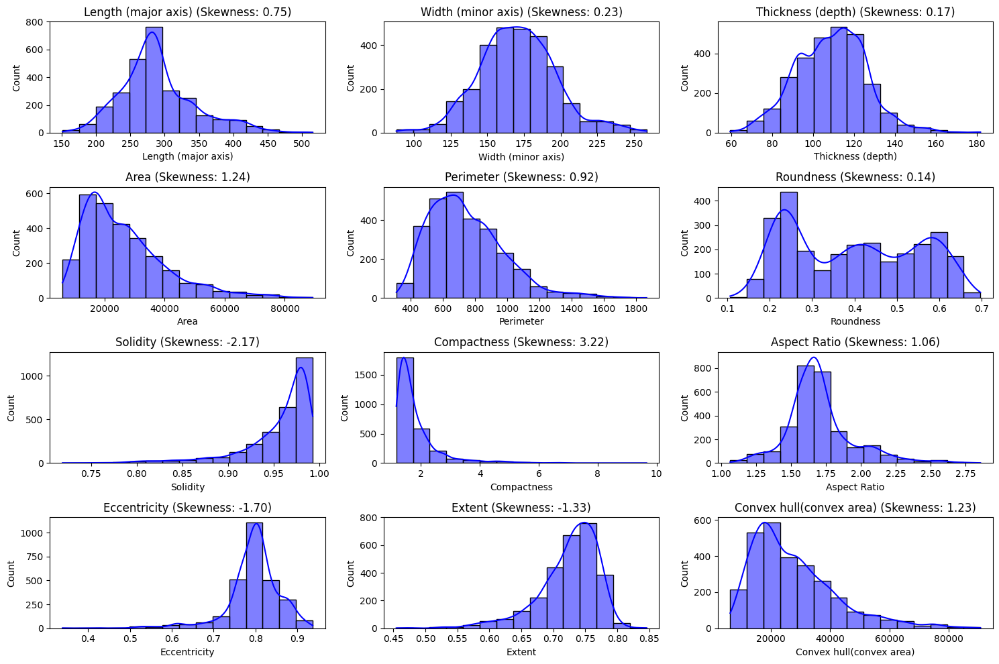

In [13]:

numeric_df = df.select_dtypes(include=['number'])
skewness_values = numeric_df.apply(skew, axis=0)
print("Skewness Values:")
print(skewness_values)
num_columns = len(numeric_df.columns)

nrows = math.ceil(num_columns / 3) 

plt.figure(figsize=(15, 10))

for i, column in enumerate(numeric_df.columns, 1):
    plt.subplot(nrows, 3, i) 
    sns.histplot(numeric_df[column], kde=True, color='blue', bins=15)
    plt.title(f'{column} (Skewness: {skewness_values[column]:.2f})')

plt.tight_layout()
plt.show()

## Splitting Data

In [14]:
train_ratio = 0.7
validation_ratio = 0.2
test_ratio = 0.1

df = df.sample(frac=1, random_state=42).reset_index(drop=True)

train_size = int(len(df) * train_ratio)
validation_size = int(len(df) * validation_ratio)

train_df = df[:train_size]
validation_df = df[train_size:train_size + validation_size]
test_df = df[train_size + validation_size:]

print("Training Data:")
print(train_df)

print("\nValidation Data:")
print(validation_df)

print("\nTesting Data:")
print(test_df)

Training Data:
      Length (major axis)  Width (minor axis)  Thickness (depth)     Area  \
0              178.880112          137.989197          80.756714  11034.0   
1              299.680664          194.056808          99.068405  14829.0   
2              253.491959          135.498322          93.661070  26813.5   
3              248.710754          145.018372          87.239090  16739.0   
4              277.364197          143.947998         103.337393  30582.5   
...                   ...                 ...                ...      ...   
1957           283.446564          146.823227         113.539688  13066.0   
1958           263.900238          158.741272         101.712997  21081.0   
1959           270.010193          156.601395          70.426323  13471.5   
1960           304.748199          189.241806         125.980762  43925.5   
1961           254.463867          150.845108          88.188347  17338.0   

       Perimeter  Roundness  Solidity  Compactness  Aspect R

## Scaling and Normalising

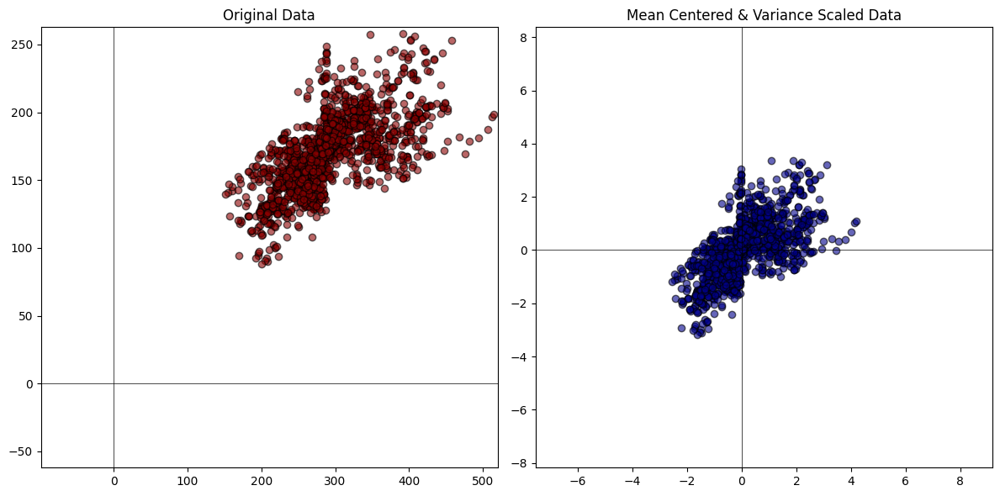

In [15]:

scaler = StandardScaler()

numeric_cols = train_df.select_dtypes(include='number').columns
non_numeric_cols = train_df.select_dtypes(exclude='number').columns

X_train_numeric = train_df[numeric_cols]
X_val_numeric = validation_df[numeric_cols]
X_test_numeric = test_df[numeric_cols]

X_train_non_numeric = train_df[non_numeric_cols]
X_val_non_numeric = validation_df[non_numeric_cols]
X_test_non_numeric = test_df[non_numeric_cols]

X_train_scaled = scaler.fit_transform(X_train_numeric)

X_val_scaled = scaler.transform(X_val_numeric)
X_test_scaled = scaler.transform(X_test_numeric)

X_train_scaled_df = pd.DataFrame(X_train_scaled, columns=numeric_cols)
X_val_scaled_df = pd.DataFrame(X_val_scaled, columns=numeric_cols)
X_test_scaled_df = pd.DataFrame(X_test_scaled, columns=numeric_cols)

X_train_final = pd.concat([X_train_scaled_df, X_train_non_numeric.reset_index(drop=True)], axis=1)
X_val_final = pd.concat([X_val_scaled_df, X_val_non_numeric.reset_index(drop=True)], axis=1)
X_test_final = pd.concat([X_test_scaled_df, X_test_non_numeric.reset_index(drop=True)], axis=1)

fig, axes = plt.subplots(1, 2, figsize=(12, 6))

axes[0].scatter(X_train_numeric.iloc[:, 0], X_train_numeric.iloc[:, 1], color='darkred', alpha=0.6, edgecolor='k')
axes[0].set_title('Original Data')
axes[0].axhline(0, color='black', linewidth=0.5)
axes[0].axvline(0, color='black', linewidth=0.5)

axes[0].set_xlim(X_train_numeric.iloc[:, 0].min() - 250, X_train_numeric.iloc[:, 0].max() + 5)
axes[0].set_ylim(X_train_numeric.iloc[:, 1].min() - 150, X_train_numeric.iloc[:, 1].max() + 5)

axes[1].scatter(X_train_scaled_df.iloc[:, 0], X_train_scaled_df.iloc[:, 1], color='darkblue', alpha=0.6, edgecolor='k')
axes[1].set_title('Mean Centered & Variance Scaled Data')
axes[1].axhline(0, color='black', linewidth=0.5)
axes[1].axvline(0, color='black', linewidth=0.5)

axes[1].set_xlim(X_train_scaled_df.iloc[:, 0].min() - 5, X_train_scaled_df.iloc[:, 0].max() + 5)
axes[1].set_ylim(X_train_scaled_df.iloc[:, 1].min() - 5, X_train_scaled_df.iloc[:, 1].max() + 5)

plt.tight_layout()
plt.show()

## Encoding

In [16]:

label_encoder = LabelEncoder()

X_train_final['Type'] = label_encoder.fit_transform(X_train_final['Type'])
X_val_final['Type'] = label_encoder.transform(X_val_final['Type'])
X_test_final['Type'] = label_encoder.transform(X_test_final['Type'])

X_train_final

,Length (major axis),Width (minor axis),Thickness (depth),Area,Perimeter,Roundness,Solidity,Compactness,Aspect Ratio,Eccentricity,Extent,Convex hull(convex area),Type
0,-2.028801,-1.250989,-1.644599,-1.142955,-1.190346,0.282304,-0.698231,-0.278749,-1.690755,-2.355452,-2.360029,-1.129900,0
1,0.198642,0.914790,-0.578284,-0.858722,-0.917914,-1.260243,0.191287,-0.373780,-0.659543,-0.481877,0.357390,-0.875864,0
2,-0.653032,-1.347206,-0.893161,0.038879,-0.317148,0.904117,0.855723,-0.616174,0.698383,0.757264,0.692475,-0.027663,0
3,-0.741193,-0.979466,-1.267122,-0.715669,-0.670656,-0.354793,0.655947,-0.217130,0.050513,0.269253,0.582309,-0.755770,1
4,-0.212852,-1.020812,-0.329696,0.321165,-0.099703,0.734635,0.830949,-0.598102,0.931374,0.900844,1.231726,0.250661,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1957,-0.100699,-0.909748,0.264398,-0.990765,-0.959452,-1.281599,-0.073685,-0.193019,0.946734,0.909819,-0.172234,-0.997699,1
1958,-0.461114,-0.449378,-0.424286,-0.390467,0.012484,-0.079341,-0.011219,0.332880,-0.168133,0.067162,-0.798239,-0.392006,1
1959,-0.348452,-0.532037,-2.246152,-0.960394,-0.624034,-1.091476,-1.316521,0.374569,0.088600,0.302256,-0.970640,-0.910917,0
1960,0.292082,0.728796,0.988859,1.320513,0.836221,1.382148,0.015012,-0.314952,-0.384769,-0.156883,-0.731217,1.338072,2


# Functions



In [46]:
class GradientMonitorCallback(tf.keras.callbacks.Callback):
    def __init__(self, model, X_train, y_train):
        self.model = model
        self.X_train = tf.convert_to_tensor(X_train)
        self.y_train = tf.convert_to_tensor(y_train)
        self.gradient_norms = []

    def on_train_batch_end(self, batch, logs=None):
        with tf.GradientTape() as tape:
            y_pred = self.model(self.X_train, training=True)
            loss = self.model.compiled_loss(self.y_train, y_pred)
        gradients = tape.gradient(loss, self.model.trainable_variables)
        gradient_norm = tf.reduce_mean([tf.norm(g) for g in gradients if g is not None])
        self.gradient_norms.append(gradient_norm.numpy())
        print(f"Batch {batch}, Gradient Norm: {gradient_norm.numpy()}")


def build_model_k_fold_callback(input_dim, output_dim, hidden_neuron_factor, Hidden_Neuron_Ratio, layers, hidden_activation, output_activation, loss_function, optimizer, epochs, batch_size, X_train, y_train, X_val, y_val):
    Hidden_Neuron = int(hidden_neuron_factor / (5 * (input_dim + output_dim)))
    Hidden_Neuron = int(Hidden_Neuron * Hidden_Neuron_Ratio)

    neuron_distribution = [
        [0.6, 0.4],
        [0.5, 0.3, 0.2],
        [0.4, 0.3, 0.2, 0.1],
        [0.35, 0.25, 0.2, 0.1, 0.1],
        [0.3, 0.25, 0.2, 0.1, 0.1, 0.05],
        [0.25, 0.2, 0.15, 0.15, 0.1, 0.1, 0.05]
    ]

    model = Sequential()
    model.add(Input(shape=(input_dim,)))

    for i in range(layers):
            if isinstance(hidden_activation, str):
                model.add(Dense(units=int(Hidden_Neuron * neuron_distribution[layers - 2][i]), activation=hidden_activation, kernel_regularizer=l2(0.001)))
            else:
                model.add(hidden_activation)
            model.add(Dropout(0.2))

    model.add(Dense(units=output_dim, activation=output_activation))
    model.compile(optimizer=optimizer, loss=loss_function, metrics=['accuracy'])


    if batch_size == -1:
        batch_size = 1
        print("Using Stochastic Gradient Descent (batch size = 1)")

    elif batch_size == 1.0:
        batch_size = len(X_train)
        print(f"Using Full Batch Gradient Descent (batch size = {batch_size})")

    elif 0 < batch_size < 1:
        batch_size = max(2, int(batch_size * len(X_train))) 
        print(f"Using Mini-Batch Gradient Descent with a set proportion (batch size = {batch_size})")

    elif batch_size > 1:
        batch_size = int(batch_size)
        print(f"Using Fixed Size Mini-Batch Gradient Descent (batch size = {batch_size})")

    else:
        raise ValueError("Batch size value must be 1, 1.0, greater than 1, or between 0 and 1.")

    gradient_monitor = GradientMonitorCallback(model, X_train, y_train)

    history = model.fit(
        X_train,
        y_train,
        epochs=epochs,
        batch_size=batch_size,
        validation_data=(X_val, y_val),
        verbose=1,
        callbacks=[gradient_monitor]
    )

    test_loss, test_accuracy = model.evaluate(X_val, y_val, verbose=1)
    return model, history, test_loss, test_accuracy, gradient_monitor

In [49]:
def plot_combined_metrics(histories, labels, metric='accuracy'):
    plt.figure(figsize=(14, 6))

    plt.subplot(1, 2, 1)
    for history, label in zip(histories, labels):
        plt.plot(history.history[metric], label=f'{label} Train')
        plt.plot(history.history[f'val_{metric}'], label=f'{label} Validation')

    plt.title('Model Accuracy Comparison')
    plt.ylabel('Accuracy')
    plt.xlabel('Epoch')
    plt.legend(loc='upper left')

    plt.subplot(1, 2, 2)
    for history, label in zip(histories, labels):
        plt.plot(history.history['loss'], label=f'{label} Train')
        plt.plot(history.history['val_loss'], label=f'{label} Validation')

    plt.title('Model Loss Comparison')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(loc='upper left')

    plt.show()

def plot_split_metrics(histories, labels, metric='accuracy'):
    plt.figure(figsize=(14, 12))

    plt.subplot(2, 2, 1)
    for history, label in zip(histories, labels):
        plt.plot(history.history[metric], label=f'{label} Train')
    plt.title('Training Accuracy Comparison')
    plt.ylabel('Accuracy')
    plt.xlabel('Epoch')
    plt.legend(loc='upper left')

    plt.subplot(2, 2, 2)
    for history, label in zip(histories, labels):
        plt.plot(history.history[f'val_{metric}'], label=f'{label} Validation')
    plt.title('Validation Accuracy Comparison')
    plt.ylabel('Accuracy')
    plt.xlabel('Epoch')
    plt.legend(loc='upper left')

    plt.subplot(2, 2, 3)
    for history, label in zip(histories, labels):
        plt.plot(history.history['loss'], label=f'{label} Train')
    plt.title('Training Loss Comparison')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(loc='upper left')

    plt.subplot(2, 2, 4)
    for history, label in zip(histories, labels):
        plt.plot(history.history['val_loss'], label=f'{label} Validation')
    plt.title('Validation Loss Comparison')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(loc='upper left')

    plt.tight_layout()
    plt.show()

def plot_confusion_matrix(model, X_test, y_test, model_name):
    y_pred = model.predict(X_test)
    y_pred_classes = y_pred.argmax(axis=1)
    cm = confusion_matrix(y_test, y_pred_classes)

    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
    plt.title(f'Confusion Matrix for {model_name}')
    plt.ylabel('Actual Label')
    plt.xlabel('Predicted Label')
    plt.show()

def plot_gradient_norms(gradient_norms):
    plt.figure(figsize=(10, 6))
    if isinstance(gradient_norms, (list, np.ndarray)):
        plt.plot(gradient_norms, label='Gradient Norms')
        plt.xlabel('Batch')
        plt.ylabel('Gradient Norm')
        plt.title('Gradient Norms over Training Batches')
        plt.legend()
        plt.show()
    else:
        raise TypeError("Expected gradient_norms to be a list or numpy array of numeric values")


In [41]:
def check_overlap(mean1, std1, mean2, std2):
    range1_min = mean1 - std1
    range1_max = mean1 + std1
    range2_min = mean2 - std2
    range2_max = mean2 + std2

    if range1_min <= range2_max and range2_min <= range1_max:
        return True
    else:
        return False

# Classes

In [19]:
class RpropOptimizer(tf.keras.optimizers.Optimizer):
    def __init__(self, learning_rate=1, initial_step_size=0.001, max_step_size=70, min_step_size=1e-6, increase_factor=1.2, decrease_factor=0.5, name="RpropOptimizer", **kwargs):
        super(RpropOptimizer, self).__init__(name, **kwargs)

        self._learning_rate = self._build_learning_rate(learning_rate)
        self.initial_step_size = initial_step_size
        self.max_step_size = max_step_size
        self.min_step_size = min_step_size
        self.increase_factor = increase_factor
        self.decrease_factor = decrease_factor

        self.slots = {}

    def build(self, var_list):
        for var in var_list:

            self.add_slot(var, "prev_gradient", tf.zeros_like(var))
            self.add_slot(var, "step_size", tf.fill(var.shape, self.initial_step_size))
            self.add_slot(var, "prev_delta_w", tf.zeros_like(var))

    def add_slot(self, var, slot_name, value):
        if var.ref() not in self.slots:
            self.slots[var.ref()] = {}
        self.slots[var.ref()][slot_name] = tf.Variable(value, trainable=False)

    def get_slot(self, var, slot_name):
        if var.ref() not in self.slots or slot_name not in self.slots[var.ref()]:
            raise KeyError(f"Slot '{slot_name}' not initialized for variable '{var.ref()}'")
        return self.slots[var.ref()][slot_name]

    def update_step(self, grad, var):
      if var.ref() not in self.slots:
          self.build([var])

      prev_grad = self.get_slot(var, "prev_gradient")
      step_size = self.get_slot(var, "step_size")
      prev_delta_w = self.get_slot(var, "prev_delta_w")

      grad_sign = tf.sign(grad)
      prev_grad_sign = tf.sign(prev_grad)

      def same_sign_logic():
          step_size_update = tf.minimum(step_size * self.increase_factor, self.max_step_size)
          delta_w = -grad_sign * step_size_update
          var.assign_add(delta_w)
          prev_delta_w.assign(delta_w)
          return step_size_update

      def opposite_sign_logic():
          step_size_update = tf.maximum(step_size * self.decrease_factor, self.min_step_size)
          var.assign_sub(prev_delta_w)
          return step_size_update

      def zero_sign_logic():
          step_size_update = step_size
          delta_w = -grad_sign * step_size_update
          var.assign_add(delta_w)
          prev_delta_w.assign(delta_w)
          return step_size_update

      step_size_update = tf.cond(
          tf.reduce_all(tf.greater(prev_grad * grad, 0)),
          true_fn=same_sign_logic,
          false_fn=lambda: tf.cond(
              tf.reduce_all(tf.less(prev_grad * grad, 0)),
              true_fn=opposite_sign_logic,
              false_fn=zero_sign_logic
          )
      )

      step_size.assign(step_size_update)
      prev_grad.assign(grad)

    def apply_gradients(self, grads_and_vars, name=None, skip_gradients_aggregation=False, **kwargs):
        for grad, var in grads_and_vars:
            self.update_step(grad, var)

    @property
    def learning_rate(self):
        return self._learning_rate

    def get_config(self):
        config = super(RpropOptimizer, self).get_config()
        config.update({
            "learning_rate": self._serialize_hyperparameter("learning_rate"),
            "initial_step_size": self.initial_step_size,
            "max_step_size": self.max_step_size,
            "min_step_size": self.min_step_size,
            "increase_factor": self.increase_factor,
            "decrease_factor": self.decrease_factor,
        })
        return config

In [71]:
class RpropOptimizer2(tf.keras.optimizers.Optimizer):
    def __init__(self, initial_step_size,increase_factor, decrease_factor,  max_step_size=50, min_step_size=1e-6,  name="RpropOptimizer2", **kwargs):
        super(RpropOptimizer2, self).__init__(name, **kwargs)

        self.initial_step_size = initial_step_size
        self.max_step_size = max_step_size
        self.min_step_size = min_step_size
        self.increase_factor = increase_factor
        self.decrease_factor = decrease_factor

        self.slots = {}

    def build(self, var_list):
        for var in var_list:
            self.add_slot(var, "prev_gradient", tf.zeros_like(var))
            self.add_slot(var, "step_size", tf.fill(var.shape, self.initial_step_size))
            self.add_slot(var, "prev_delta_w", tf.zeros_like(var))

    def add_slot(self, var, slot_name, value):
        if var.ref() not in self.slots:
            self.slots[var.ref()] = {}
        self.slots[var.ref()][slot_name] = tf.Variable(value, trainable=False)

    def get_slot(self, var, slot_name):
        if var.ref() not in self.slots or slot_name not in self.slots[var.ref()]:
            raise KeyError(f"Slot '{slot_name}' not initialized for variable '{var.ref()}'")
        return self.slots[var.ref()][slot_name]

    def update_step(self, grad, var):
      if var.ref() not in self.slots:
          self.build([var])

      prev_grad = self.get_slot(var, "prev_gradient")
      step_size = self.get_slot(var, "step_size")
      prev_delta_w = self.get_slot(var, "prev_delta_w")

      grad_sign = tf.sign(grad)
      prev_grad_sign = tf.sign(prev_grad)

      def same_sign_logic():
          step_size_update = tf.minimum(step_size * self.increase_factor, self.max_step_size)
          delta_w = -grad_sign * step_size_update
          var.assign_add(delta_w)
          prev_delta_w.assign(delta_w)
          return step_size_update

      def opposite_sign_logic():
          step_size_update = tf.maximum(step_size * self.decrease_factor, self.min_step_size)
          var.assign_sub(prev_delta_w)
          return step_size_update

      def zero_sign_logic():
          step_size_update = step_size
          delta_w = -grad_sign * step_size_update
          var.assign_add(delta_w)
          prev_delta_w.assign(delta_w)
          return step_size_update

      step_size_update = tf.cond(
          tf.reduce_all(tf.greater(prev_grad * grad, 0)),
          true_fn=same_sign_logic,
          false_fn=lambda: tf.cond(
              tf.reduce_all(tf.less(prev_grad * grad, 0)),
              true_fn=opposite_sign_logic,
              false_fn=zero_sign_logic
          )
      )

      step_size.assign(step_size_update)
      prev_grad.assign(grad)

    def apply_gradients(self, grads_and_vars, name=None, skip_gradients_aggregation=False, **kwargs):
        for grad, var in grads_and_vars:
            self.update_step(grad, var)

    def get_config(self):
        config = super(RpropOptimizer, self).get_config()
        config.update({
            "initial_step_size": self.initial_step_size,
            "max_step_size": self.max_step_size,
            "min_step_size": self.min_step_size,
            "increase_factor": self.increase_factor,
            "decrease_factor": self.decrease_factor,
        })
        return config
    
class RpropOptimizer3(tf.keras.optimizers.Optimizer):
    def __init__(self, initial_step_size,increase_factor, decrease_factor,  max_step_size=50, min_step_size=1e-6, clipnorm=3, name="RpropOptimizer3", **kwargs):
        super(RpropOptimizer3, self).__init__(name, **kwargs)

        self.initial_step_size = initial_step_size
        self.max_step_size = max_step_size
        self.min_step_size = min_step_size
        self.increase_factor = increase_factor
        self.decrease_factor = decrease_factor
        self.clipnorm = clipnorm 

        self.slots = {}

    def build(self, var_list):
        for var in var_list:
            self.add_slot(var, "prev_gradient", tf.zeros_like(var))
            self.add_slot(var, "step_size", tf.fill(var.shape, self.initial_step_size))
            self.add_slot(var, "prev_delta_w", tf.zeros_like(var))

    def add_slot(self, var, slot_name, value):
        if var.ref() not in self.slots:
            self.slots[var.ref()] = {}
        self.slots[var.ref()][slot_name] = tf.Variable(value, trainable=False)

    def get_slot(self, var, slot_name):
        if var.ref() not in self.slots or slot_name not in self.slots[var.ref()]:
            raise KeyError(f"Slot '{slot_name}' not initialized for variable '{var.ref()}'")
        return self.slots[var.ref()][slot_name]

    def update_step(self, grad, var):
      if var.ref() not in self.slots:
          self.build([var])

      prev_grad = self.get_slot(var, "prev_gradient")
      step_size = self.get_slot(var, "step_size")
      prev_delta_w = self.get_slot(var, "prev_delta_w")

      grad_sign = tf.sign(grad)
      prev_grad_sign = tf.sign(prev_grad)

      def same_sign_logic():
          step_size_update = tf.minimum(step_size * self.increase_factor, self.max_step_size)
          delta_w = -grad_sign * step_size_update
          var.assign_add(delta_w)
          prev_delta_w.assign(delta_w)
          return step_size_update

      def opposite_sign_logic():
          step_size_update = tf.maximum(step_size * self.decrease_factor, self.min_step_size)
          var.assign_sub(prev_delta_w)
          return step_size_update

      def zero_sign_logic():
          step_size_update = step_size
          delta_w = -grad_sign * step_size_update
          var.assign_add(delta_w)
          prev_delta_w.assign(delta_w)
          return step_size_update

      step_size_update = tf.cond(
          tf.reduce_all(tf.greater(prev_grad * grad, 0)),
          true_fn=same_sign_logic,
          false_fn=lambda: tf.cond(
              tf.reduce_all(tf.less(prev_grad * grad, 0)),
              true_fn=opposite_sign_logic,
              false_fn=zero_sign_logic
          )
      )

      step_size.assign(step_size_update)
      prev_grad.assign(grad)

    def apply_gradients(self, grads_and_vars, name=None, skip_gradients_aggregation=False, **kwargs):
        for grad, var in grads_and_vars:
            self.update_step(grad, var)

    def get_config(self):
        config = super(RpropOptimizer, self).get_config()
        config.update({
            "initial_step_size": self.initial_step_size,
            "max_step_size": self.max_step_size,
            "min_step_size": self.min_step_size,
            "increase_factor": self.increase_factor,
            "decrease_factor": self.decrease_factor,
            "clipnorm": self.clipnorm,
        })
        return config

In [21]:
class HydridAMSGradRPropOptimizer(tf.keras.optimizers.Optimizer):
    def __init__(self, RProp_Percentage, learning_rate=0.001, beta_1=0.9, beta_2=0.999, epsilon=1e-7, initial_step_size=0.002, max_step_size=70, min_step_size=1e-6, increase_factor=2.7, decrease_factor=0.33, name="HydridAMSGradRPropOptimizer", **kwargs):
        super(HydridAMSGradRPropOptimizer, self).__init__(name, **kwargs)

        self._learning_rate = self._build_learning_rate(learning_rate)
        self.beta_1 = beta_1
        self.beta_2 = beta_2
        self.epsilon = epsilon
        self.initial_step_size = initial_step_size
        self.max_step_size = max_step_size
        self.min_step_size = min_step_size
        self.increase_factor = increase_factor
        self.decrease_factor = decrease_factor
        self.RProp_Percentage = RProp_Percentage

        self.slots = {}

    def build(self, var_list):
        for var in var_list:
            self.add_slot(var, "momentum", tf.zeros_like(var))
            self.add_slot(var, "velocity", tf.zeros_like(var))
            self.add_slot(var, "prev_gradient", tf.zeros_like(var))
            self.add_slot(var, "step_size", tf.fill(var.shape, self.initial_step_size))
            self.add_slot(var, "prev_delta_w", tf.zeros_like(var))

    def add_slot(self, var, slot_name, value):
        if var.ref() not in self.slots:
            self.slots[var.ref()] = {}
        self.slots[var.ref()][slot_name] = tf.Variable(value, trainable=False)

    def get_slot(self, var, slot_name):
        if var.ref() not in self.slots or slot_name not in self.slots[var.ref()]:
            raise KeyError(f"Slot '{slot_name}' not initialized for variable '{var.ref()}'")
        return self.slots[var.ref()][slot_name]

    def update_step(self, grad, var):
        if var.ref() not in self.slots:
            self.build([var])

        m = self.get_slot(var, "momentum")
        v = self.get_slot(var, "velocity")

        grad = tf.cast(grad, var.dtype)
        lr = tf.cast(self._learning_rate, var.dtype)
        local_step = tf.cast(self.iterations + 1, var.dtype)

        beta_1_power = tf.pow(self.beta_1, local_step)
        beta_2_power = tf.pow(self.beta_2, local_step)
        alpha = lr * tf.sqrt(1 - beta_2_power) / (1 - beta_1_power)

        m_t = (self.beta_1 * m) + (1 - self.beta_1) * grad
        m.assign(m_t)

        v_t = (self.beta_2 * v) + (1 - self.beta_2) * tf.square(grad)
        v.assign(v_t)

        m_hat = m_t / (1 - beta_1_power)
        v_hat = v_t / (1 - beta_2_power)

        update_AMSGrad = -alpha * m_hat / (tf.sqrt(v_hat) + self.epsilon)

        prev_grad = self.get_slot(var, "prev_gradient")
        step_size = self.get_slot(var, "step_size")
        prev_delta_w = self.get_slot(var, "prev_delta_w")

        grad_sign = tf.sign(grad)
        prev_grad_sign = tf.sign(prev_grad)

        def same_sign_logic():
            step_size_update = tf.minimum(step_size * self.increase_factor, self.max_step_size)
            delta_w = -grad_sign * step_size_update
            prev_delta_w.assign(delta_w)
            update_RProp = delta_w
            return step_size_update, update_RProp

        def opposite_sign_logic():
            step_size_update = tf.maximum(step_size * self.decrease_factor, self.min_step_size)
            update_RProp = -prev_delta_w
            return step_size_update, update_RProp

        def zero_sign_logic():
            step_size_update = step_size
            delta_w = -grad_sign * step_size_update
            prev_delta_w.assign(delta_w)
            update_RProp = delta_w
            return step_size_update, update_RProp

        step_size_update, update_RProp = tf.cond(
            tf.reduce_all(tf.greater(prev_grad * grad, 0)),
            true_fn=same_sign_logic,
            false_fn=lambda: tf.cond(
                tf.reduce_all(tf.less(prev_grad * grad, 0)),
                true_fn=opposite_sign_logic,
                false_fn=zero_sign_logic
            )
        )

        step_size.assign(step_size_update)
        prev_grad.assign(grad)

        var.assign_add((1-self.RProp_Percentage)*update_AMSGrad + self.RProp_Percentage * update_RProp)

    def apply_gradients(self, grads_and_vars, name=None, skip_gradients_aggregation=False, **kwargs):
        for grad, var in grads_and_vars:
            self.update_step(grad, var)

    @property
    def learning_rate(self):
        return self._learning_rate

    def get_config(self):
        config = super(HydridAMSGradRPropOptimizer, self).get_config()
        config.update({
            "learning_rate": self._serialize_hyperparameter("learning_rate"),
            "beta_1": self.beta_1,
            "beta_2": self.beta_2,
            "epsilon": self.epsilon,
        })
        return config

# Hyperparameter Optimisation

## Hyperparameters

In [22]:
input_dim = X_train_final.shape[1] - 1
output_dim = 3
hidden_neuron_factor = X_train_final.shape[0]
Hidden_Neuron = int(X_train_final.shape[0]/(input_dim + output_dim))
hidden_activation = 'relu'
output_activation = 'softmax'
loss_function = 'sparse_categorical_crossentropy'
epochs = 60
batch_size = 32
X_train = X_train_final.drop(columns=['Type'])
y_train = X_train_final['Type']
X_val = X_val_final.drop(columns=['Type'])
y_val = X_val_final['Type']
X_test = X_test_final.drop(columns=['Type'])
y_test = X_test_final['Type']

In [23]:
def build_model_k_fold(input_dim, output_dim, hidden_neuron_factor, Hidden_Neuron_Ratio, layers, hidden_activation, output_activation, loss_function, optimizer, epochs, batch_size, X_train, y_train, X_val, y_val):
    Hidden_Neuron = int(hidden_neuron_factor / (5 * (input_dim + output_dim)))
    Hidden_Neuron = int(Hidden_Neuron * Hidden_Neuron_Ratio)

    neuron_distribution = [
        [0.6, 0.4],
        [0.5, 0.3, 0.2],
        [0.4, 0.3, 0.2, 0.1],
        [0.35, 0.25, 0.2, 0.1, 0.1],
        [0.3, 0.25, 0.2, 0.1, 0.1, 0.05],
        [0.25, 0.2, 0.15, 0.15, 0.1, 0.1, 0.05]
    ]

    model = Sequential()
    model.add(Input(shape=(input_dim,)))

    for i in range(layers):
            if isinstance(hidden_activation, str):
                model.add(Dense(units=int(Hidden_Neuron * neuron_distribution[layers - 2][i]), activation=hidden_activation, kernel_regularizer=l2(0.001)))
            else:
                model.add(hidden_activation)
            model.add(Dropout(0.2))

    model.add(Dense(units=output_dim, activation=output_activation))
    model.compile(optimizer=optimizer, loss=loss_function, metrics=['accuracy'])


    if batch_size == -1:
        batch_size = 1
        print("Using Stochastic Gradient Descent (batch size = 1)")

    elif batch_size == 1.0:
        batch_size = len(X_train)
        print(f"Using Full Batch Gradient Descent (batch size = {batch_size})")

    elif 0 < batch_size < 1:
        batch_size = max(2, int(batch_size * len(X_train))) 
        print(f"Using Mini-Batch Gradient Descent with a set proportion (batch size = {batch_size})")

    elif batch_size > 1:
        batch_size = int(batch_size)
        print(f"Using Fixed Size Mini-Batch Gradient Descent (batch size = {batch_size})")

    else:
        raise ValueError("Batch size value must be 1, 1.0, greater than 1, or between 0 and 1.")


    history = model.fit(
        X_train,
        y_train,
        epochs=epochs,
        batch_size=batch_size,
        validation_data=(X_val, y_val),
        verbose=1
    )

    test_loss, test_accuracy = model.evaluate(X_val, y_val, verbose=1)
    return model, history, test_loss, test_accuracy


## Hidden Neurons VS Hidden Layers

Config: layers=2, hidden_neurons_factor=1
Training on fold 1...

Using Fixed Size Mini-Batch Gradient Descent (batch size = 32)
Epoch 1/60


69/69 [==============================] - 1s 3ms/step - loss: 1.1361 - accuracy: 0.4112 - val_loss: 1.0399 - val_accuracy: 0.4715
Epoch 2/60
69/69 [==============================] - 0s 1ms/step - loss: 1.0442 - accuracy: 0.4515 - val_loss: 0.9869 - val_accuracy: 0.5063
Epoch 3/60
69/69 [==============================] - 0s 1ms/step - loss: 0.9864 - accuracy: 0.5113 - val_loss: 0.9517 - val_accuracy: 0.5253
Epoch 4/60
69/69 [==============================] - 0s 1ms/step - loss: 0.9599 - accuracy: 0.5240 - val_loss: 0.9263 - val_accuracy: 0.5538
Epoch 5/60
69/69 [==============================] - 0s 1ms/step - loss: 0.9398 - accuracy: 0.5431 - val_loss: 0.9056 - val_accuracy: 0.5633
Epoch 6/60
69/69 [==============================] - 0s 1ms/step - loss: 0.9308 - accuracy: 0.5508 - val_loss: 0.8928 - val_accuracy: 0.5696
Epoch 7/60
69/69 [============

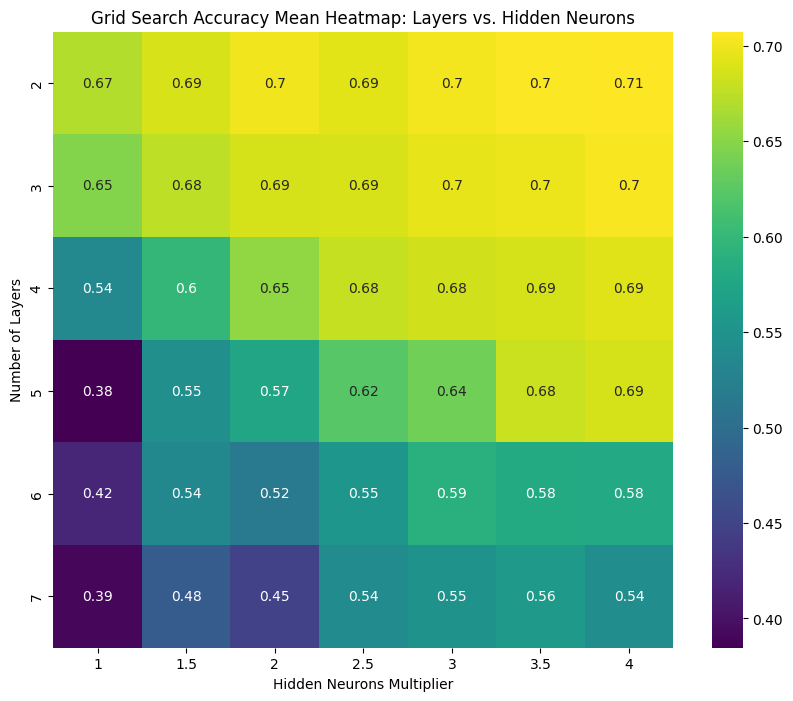

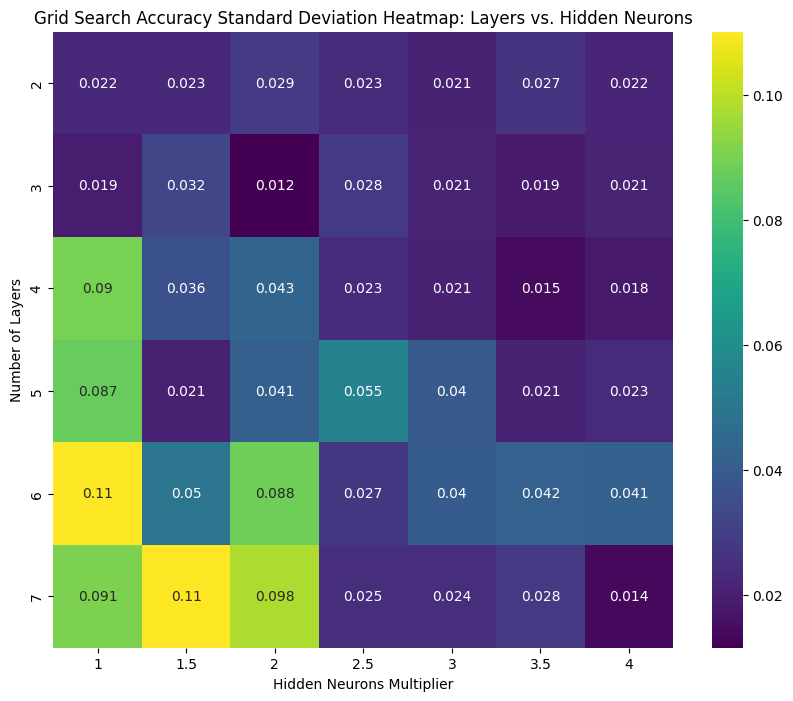

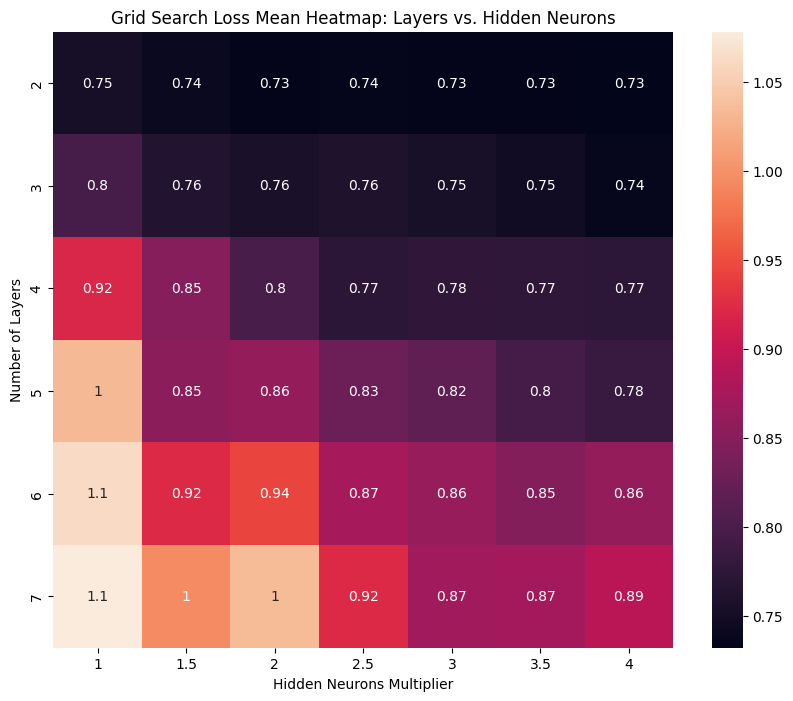

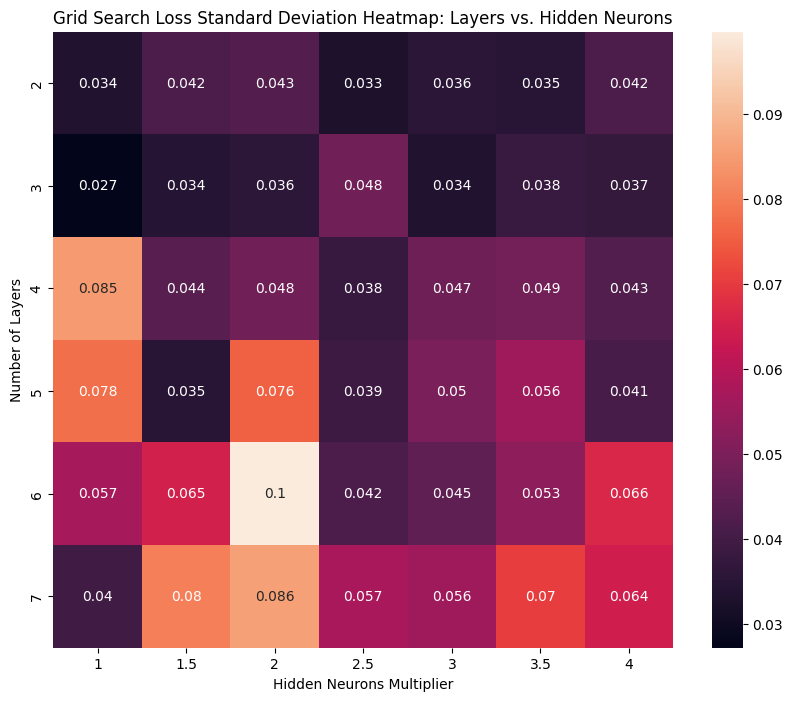

In [24]:
k_fold_patterns = pd.concat([X_train_final, X_val_final], axis=0)
k_fold_labels = pd.concat([X_train_final['Type'], X_val_final['Type']], axis=0)

k = 8
kf = KFold(n_splits=k, shuffle=True, random_state=42)

layer_values = [2, 3, 4, 5, 6, 7]
hidden_neurons_values = [1, 1.5, 2, 2.5, 3, 3.5, 4]

accuracy_results = [[0 for _ in hidden_neurons_values] for _ in layer_values]
loss_results = [[0 for _ in hidden_neurons_values] for _ in layer_values]
std_accuracy_results = [[0 for _ in hidden_neurons_values] for _ in layer_values]
std_loss_results = [[0 for _ in hidden_neurons_values] for _ in layer_values]

for layer_idx, layers in enumerate(layer_values):
    for hn_idx, hidden_neurons_factor in enumerate(hidden_neurons_values):

        all_accuracies = []

        
        print(f"Config: layers={layers}, hidden_neurons_factor={hidden_neurons_factor}")

        fold_accuracies = []
        fold_loss = []
        fold = 1

        for train_index, val_index in kf.split(k_fold_patterns):
            print(f"Training on fold {fold}...")

            X_train, X_val = k_fold_patterns.iloc[train_index].drop(columns=['Type']), k_fold_patterns.iloc[val_index].drop(columns=['Type'])
            y_train, y_val = k_fold_labels.iloc[train_index], k_fold_labels.iloc[val_index]


            model, history, test_loss, test_accuracy = build_model_k_fold(
                    input_dim, output_dim, X_train.shape[0], hidden_neurons_factor, layers,
                    hidden_activation, output_activation, loss_function, RpropOptimizer(), epochs, batch_size, X_train, y_train, X_val, y_val)

            fold_accuracies.append(test_accuracy)
            fold_loss.append(test_loss)
            fold += 1

      
        avg_accuracy = np.mean(fold_accuracies)
        std_accuracy = np.std(fold_accuracies)
        accuracy_results[layer_idx][hn_idx] = avg_accuracy
        std_accuracy_results[layer_idx][hn_idx] = std_accuracy
        

        avg_loss = np.mean(fold_loss)
        std_loss = np.std(fold_loss)
        loss_results[layer_idx][hn_idx] = avg_loss
        std_loss_results[layer_idx][hn_idx] = std_loss

        print(f"Average Accuracy for config: layers={layers}, hidden_neurons_factor={hidden_neurons_factor}: {avg_accuracy:.4f}")

accuracy_array = np.array(accuracy_results)

plt.figure(figsize=(10, 8))
ax = sns.heatmap(accuracy_array, annot=True, cmap="viridis", xticklabels=hidden_neurons_values, yticklabels=layer_values)

ax.set_xlabel("Hidden Neurons Multiplier")
ax.set_ylabel("Number of Layers")
ax.set_title("Grid Search Accuracy Mean Heatmap: Layers vs. Hidden Neurons")

plt.show()

std_accuracy_array = np.array(std_accuracy_results)

plt.figure(figsize=(10, 8))
ax = sns.heatmap(std_accuracy_array, annot=True, cmap="viridis", xticklabels=hidden_neurons_values, yticklabels=layer_values)

ax.set_xlabel("Hidden Neurons Multiplier")
ax.set_ylabel("Number of Layers")
ax.set_title("Grid Search Accuracy Standard Deviation Heatmap: Layers vs. Hidden Neurons")

plt.show()

loss_array = np.array(loss_results)

plt.figure(figsize=(10, 8))
ax = sns.heatmap(loss_array, annot=True, xticklabels=hidden_neurons_values, yticklabels=layer_values)

ax.set_xlabel("Hidden Neurons Multiplier")
ax.set_ylabel("Number of Layers")
ax.set_title("Grid Search Loss Mean Heatmap: Layers vs. Hidden Neurons")

plt.show()

std_loss_array = np.array(std_loss_results)

plt.figure(figsize=(10, 8))
ax = sns.heatmap(std_loss_array, annot=True, xticklabels=hidden_neurons_values, yticklabels=layer_values)

ax.set_xlabel("Hidden Neurons Multiplier")
ax.set_ylabel("Number of Layers")
ax.set_title("Grid Search Loss Standard Deviation Heatmap: Layers vs. Hidden Neurons")

plt.show()

Config 1:
  Mean Accuracy: 0.6950
  95% Confidence Interval: (0.6853, 0.7047)

Config 2:
  Mean Accuracy: 0.6847
  95% Confidence Interval: (0.6707, 0.6988)

Config 3:
  Mean Accuracy: 0.6473
  95% Confidence Interval: (0.6039, 0.6906)

Config 4:
  Mean Accuracy: 0.5903
  95% Confidence Interval: (0.5130, 0.6676)

Config 5:
  Mean Accuracy: 0.5391
  95% Confidence Interval: (0.4956, 0.5827)

Config 6:
  Mean Accuracy: 0.5010
  95% Confidence Interval: (0.4537, 0.5484)



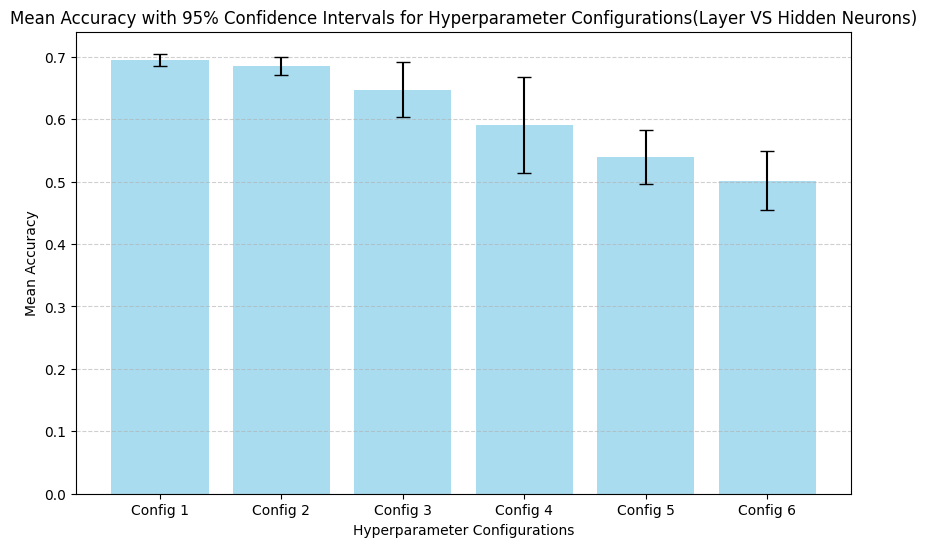

In [25]:
confidence_intervals = []
means = []
std_devs = []

for accuracies in accuracy_results:
    mean_accuracy = np.mean(accuracies)
    std_dev_accuracy = np.std(accuracies, ddof=1)
    n = len(accuracies)
    z = 1.96

    margin_of_error = z * (std_dev_accuracy / np.sqrt(n))
    confidence_interval = (mean_accuracy - margin_of_error, mean_accuracy + margin_of_error)

    means.append(mean_accuracy)
    std_devs.append(std_dev_accuracy)
    confidence_intervals.append(confidence_interval)


for i, (mean, ci) in enumerate(zip(means, confidence_intervals)):
    print(f"Config {i + 1}:")
    print(f"  Mean Accuracy: {mean:.4f}")
    print(f"  95% Confidence Interval: ({ci[0]:.4f}, {ci[1]:.4f})")
    print()

config_labels = [f"Config {i + 1}" for i in range(len(means))]
lower_bounds = [mean - ci[0] for mean, ci in zip(means, confidence_intervals)]
upper_bounds = [ci[1] - mean for mean, ci in zip(means, confidence_intervals)]

plt.figure(figsize=(10, 6))
plt.bar(config_labels, means, yerr=[lower_bounds, upper_bounds], capsize=5, alpha=0.7, color='skyblue')
plt.xlabel('Hyperparameter Configurations')
plt.ylabel('Mean Accuracy')
plt.title('Mean Accuracy with 95% Confidence Intervals for Hyperparameter Configurations(Layer VS Hidden Neurons)')
plt.grid(axis='y', linestyle='--', alpha=0.6)
plt.show()

In [44]:
print(check_overlap(accuracy_results[0][2],std_accuracy_results[0][2],accuracy_results[0][6],std_accuracy_results[0][6]))

True


## Batch Size VS Epoch

Config: Epoch=30, Batch Size Ratio=-1
Training on fold 1...
Using Stochastic Gradient Descent (batch size = 1)
Epoch 1/30
2017/2017 [==============================] - 3s 842us/step - loss: 59.5842 - accuracy: 0.3421 - val_loss: 112.1404 - val_accuracy: 0.3386
Epoch 2/30
2017/2017 [==============================] - 2s 806us/step - loss: 67.6906 - accuracy: 0.3416 - val_loss: 112.2005 - val_accuracy: 0.3386
Epoch 3/30
2017/2017 [==============================] - 2s 810us/step - loss: 67.5903 - accuracy: 0.3342 - val_loss: 32.3501 - val_accuracy: 0.3525
Epoch 4/30
2017/2017 [==============================] - 2s 829us/step - loss: 68.0894 - accuracy: 0.3297 - val_loss: 79.6456 - val_accuracy: 0.3525
Epoch 5/30
2017/2017 [==============================] - 2s 820us/step - loss: 69.9510 - accuracy: 0.3376 - val_loss: 79.5530 - val_accuracy: 0.3525
Epoch 6/30
2017/2017 [==============================] - 2s 806us/step - loss: 70.6518 - accuracy: 0.3352 - val_loss: 79.5132 - val_accuracy: 0.3525

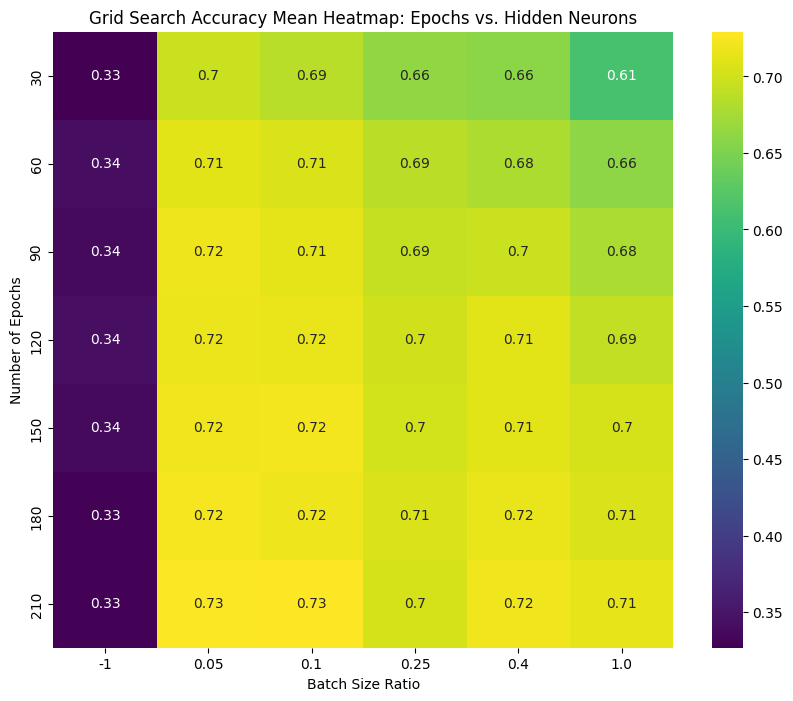

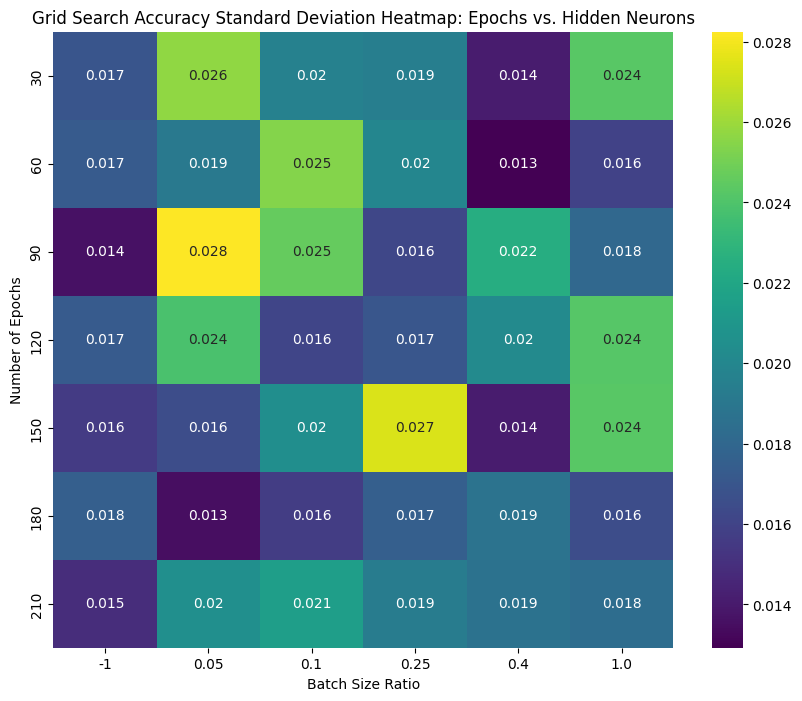

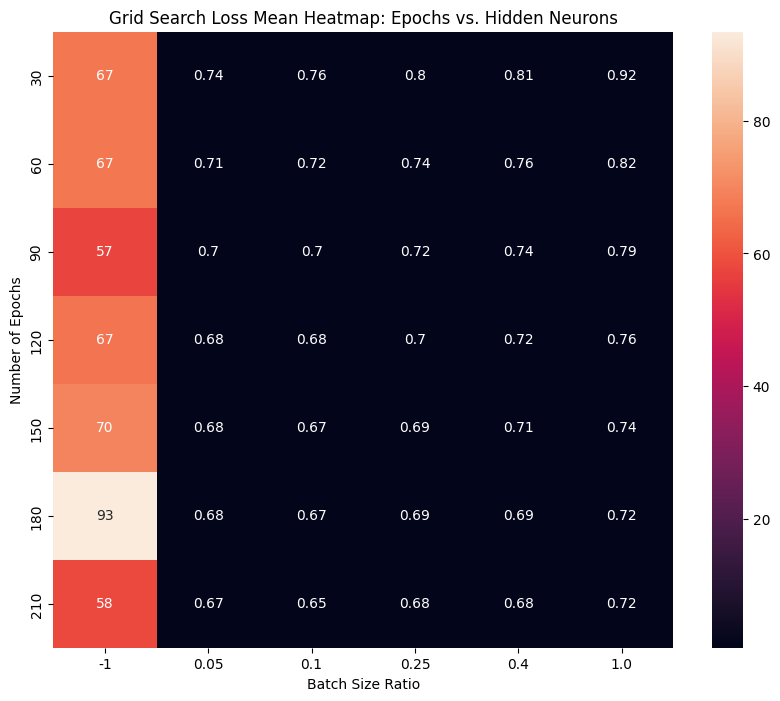

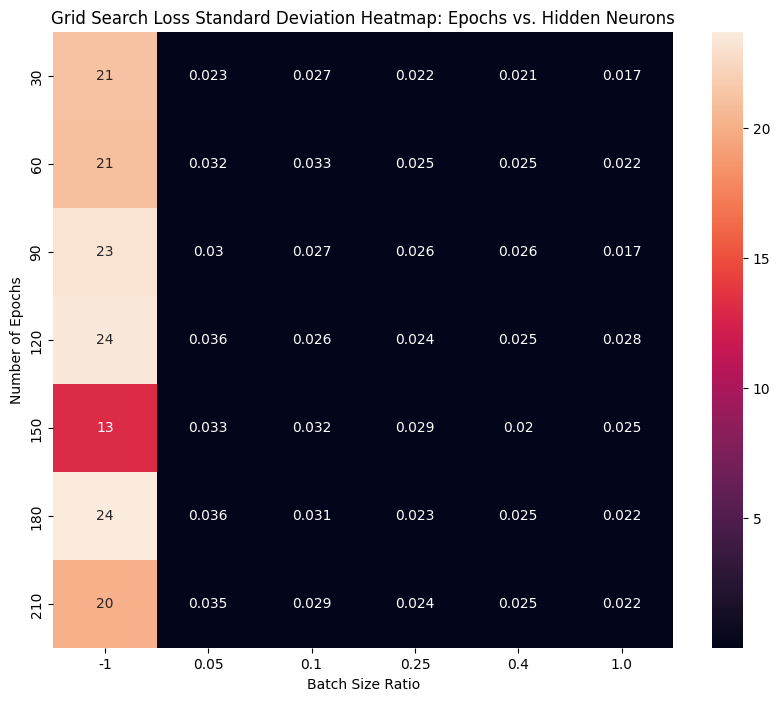

In [26]:
k_fold_patterns = pd.concat([X_train_final, X_val_final], axis=0)
k_fold_labels = pd.concat([X_train_final['Type'], X_val_final['Type']], axis=0)
k = 5
kf = KFold(n_splits=k, shuffle=True, random_state=42)

batch_size_values = [-1, 0.05, 0.1, 0.25, 0.4, 1.0] # '-1':  SGD, and '1.0' for a full batch size
epoch_values = [30, 60, 90, 120, 150, 180, 210]

accuracy_results_2 = [[0 for _ in batch_size_values] for _ in epoch_values]
loss_results_2 = [[0 for _ in batch_size_values] for _ in epoch_values]
std_accuracy_results_2 = [[0 for _ in batch_size_values] for _ in epoch_values]
std_loss_results_2 = [[0 for _ in batch_size_values] for _ in epoch_values]

for epoch_idx, epochs in enumerate(epoch_values):
    for batch_idx, batch_size in enumerate(batch_size_values):

        all_accuracies_2 = []

        
        print(f"Config: Epoch={epochs}, Batch Size Ratio={batch_size}")

        fold_accuracies_2 = []
        fold_loss_2 = []
        fold = 1

        for train_index, val_index in kf.split(k_fold_patterns):
            print(f"Training on fold {fold}...")

            X_train, X_val = k_fold_patterns.iloc[train_index].drop(columns=['Type']), k_fold_patterns.iloc[val_index].drop(columns=['Type'])
            y_train, y_val = k_fold_labels.iloc[train_index], k_fold_labels.iloc[val_index]


            model_2 ,history_2 , test_loss_2 , test_accuracy_2  = build_model_k_fold(
                    input_dim, output_dim, X_train.shape[0], 4, 2,
                    hidden_activation, output_activation, loss_function, RpropOptimizer(), epochs, batch_size, X_train, y_train, X_val, y_val)

            fold_accuracies_2.append(test_accuracy_2)
            fold_loss_2.append(test_loss_2)
            fold += 1

      
        avg_accuracy_2 = np.mean(fold_accuracies_2)
        std_accuracy_2 = np.std(fold_accuracies_2)
        accuracy_results_2[epoch_idx][batch_idx] = avg_accuracy_2
        std_accuracy_results_2[epoch_idx][batch_idx] = std_accuracy_2
        

        avg_loss_2 = np.mean(fold_loss_2)
        std_loss_2 = np.std(fold_loss_2)
        loss_results_2[epoch_idx][batch_idx] = avg_loss_2
        std_loss_results_2[epoch_idx][batch_idx] = std_loss_2

        print(f"Average Accuracy for config: Epoch={epochs}, hbatch_size_ratio={batch_size}: {avg_accuracy_2:.4f}")

accuracy_array_2 = np.array(accuracy_results_2)

plt.figure(figsize=(10, 8))
ax = sns.heatmap(accuracy_array_2, annot=True, cmap="viridis", xticklabels=batch_size_values, yticklabels=epoch_values)

ax.set_xlabel("Batch Size Ratio")
ax.set_ylabel("Number of Epochs")
ax.set_title("Grid Search Accuracy Mean Heatmap: Epochs vs. Hidden Neurons")

plt.show()

std_accuracy_array_2 = np.array(std_accuracy_results_2)

plt.figure(figsize=(10, 8))
ax = sns.heatmap(std_accuracy_array_2, annot=True, cmap="viridis", xticklabels=batch_size_values, yticklabels=epoch_values)

ax.set_xlabel("Batch Size Ratio")
ax.set_ylabel("Number of Epochs")
ax.set_title("Grid Search Accuracy Standard Deviation Heatmap: Epochs vs. Hidden Neurons")

plt.show()

loss_array_2 = np.array(loss_results_2)

plt.figure(figsize=(10, 8))
ax = sns.heatmap(loss_array_2, annot=True, xticklabels=batch_size_values, yticklabels=epoch_values)

ax.set_xlabel("Batch Size Ratio")
ax.set_ylabel("Number of Epochs")
ax.set_title("Grid Search Loss Mean Heatmap: Epochs vs. Hidden Neurons")

plt.show()

std_loss_array_2 = np.array(std_loss_results_2)

plt.figure(figsize=(10, 8))
ax = sns.heatmap(std_loss_array_2, annot=True, xticklabels=batch_size_values, yticklabels=epoch_values)

ax.set_xlabel("Batch Size Ratio")
ax.set_ylabel("Number of Epochs")
ax.set_title("Grid Search Loss Standard Deviation Heatmap: Epochs vs. Hidden Neurons")

plt.show()

Config 1:
  Mean Accuracy: 0.6070
  95% Confidence Interval: (0.4947, 0.7193)

Config 2:
  Mean Accuracy: 0.6310
  95% Confidence Interval: (0.5162, 0.7458)

Config 3:
  Mean Accuracy: 0.6396
  95% Confidence Interval: (0.5204, 0.7588)

Config 4:
  Mean Accuracy: 0.6462
  95% Confidence Interval: (0.5265, 0.7660)

Config 5:
  Mean Accuracy: 0.6492
  95% Confidence Interval: (0.5263, 0.7720)

Config 6:
  Mean Accuracy: 0.6501
  95% Confidence Interval: (0.5243, 0.7760)

Config 7:
  Mean Accuracy: 0.6535
  95% Confidence Interval: (0.5258, 0.7812)



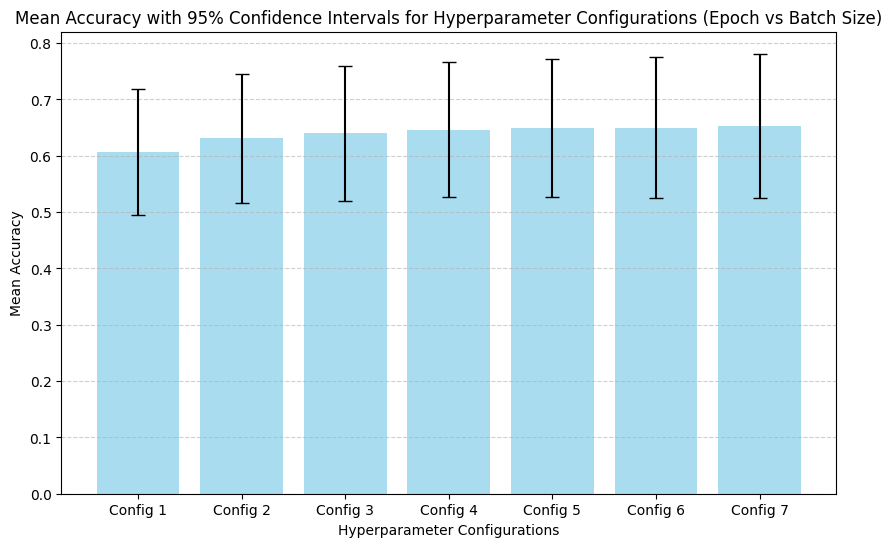

In [40]:


confidence_intervals_2 = []
means_2 = []
std_devs_2 = []

for accuracies in accuracy_results_2:
    mean_accuracy_2 = np.mean(accuracies)
    std_dev_accuracy_2 = np.std(accuracies, ddof=1)
    n = len(accuracies)
    z = 1.96

    margin_of_error = z * (std_dev_accuracy_2 / np.sqrt(n))
    confidence_interval = (mean_accuracy_2 - margin_of_error, mean_accuracy_2 + margin_of_error)

    means_2.append(mean_accuracy_2)
    std_devs_2.append(std_dev_accuracy_2)
    confidence_intervals_2.append(confidence_interval)


for i, (mean, ci) in enumerate(zip(means_2, confidence_intervals_2)):
    print(f"Config {i + 1}:")
    print(f"  Mean Accuracy: {mean:.4f}")
    print(f"  95% Confidence Interval: ({ci[0]:.4f}, {ci[1]:.4f})")
    print()

config_labels_2 = [f"Config {i + 1}" for i in range(len(means_2))]
lower_bounds_2 = [mean - ci[0] for mean, ci in zip(means_2, confidence_intervals_2)]
upper_bounds_2 = [ci[1] - mean for mean, ci in zip(means_2, confidence_intervals_2)]

plt.figure(figsize=(10, 6))
plt.bar(config_labels_2, means_2, yerr=[lower_bounds_2, upper_bounds_2], capsize=5, alpha=0.7, color='skyblue')
plt.xlabel('Hyperparameter Configurations')
plt.ylabel('Mean Accuracy')
plt.title('Mean Accuracy with 95% Confidence Intervals for Hyperparameter Configurations (Epoch vs Batch Size)')
plt.grid(axis='y', linestyle='--', alpha=0.6)
plt.show()

In [43]:
print(check_overlap(accuracy_results_2[0][2],std_accuracy_results_2[0][2],accuracy_results_2[6][1],std_accuracy_results_2[6][1]))

False


## Activation Function

Config: Activation_function=relu
Training on fold 1...
Using Mini-Batch Gradient Descent with a set proportion (batch size = 113)
Epoch 1/310
21/21 [==============================] - 1s 7ms/step - loss: 1.1550 - accuracy: 0.4116 - val_loss: 1.0460 - val_accuracy: 0.5613
Epoch 2/310
21/21 [==============================] - 0s 2ms/step - loss: 1.0300 - accuracy: 0.5139 - val_loss: 0.9702 - val_accuracy: 0.6087
Epoch 3/310
21/21 [==============================] - 0s 2ms/step - loss: 0.9813 - accuracy: 0.5456 - val_loss: 0.9391 - val_accuracy: 0.6364
Epoch 4/310
21/21 [==============================] - 0s 2ms/step - loss: 0.9435 - accuracy: 0.5729 - val_loss: 0.9020 - val_accuracy: 0.6640
Epoch 5/310
21/21 [==============================] - 0s 2ms/step - loss: 0.9146 - accuracy: 0.5897 - val_loss: 0.8680 - val_accuracy: 0.6759
Epoch 6/310
21/21 [==============================] - 0s 2ms/step - loss: 0.8842 - accuracy: 0.6086 - val_loss: 0.8406 - val_accuracy: 0.6838
Epoch 7/310
21/21 [=====

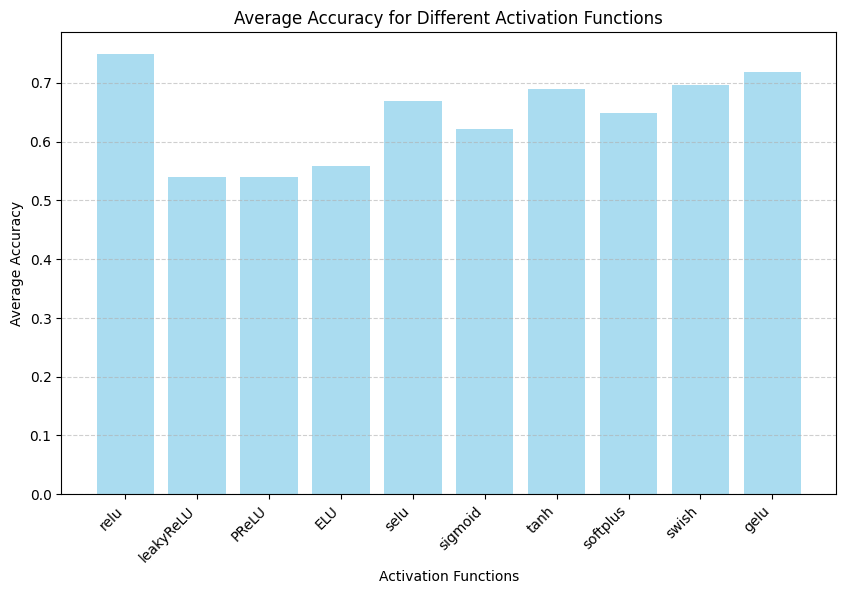

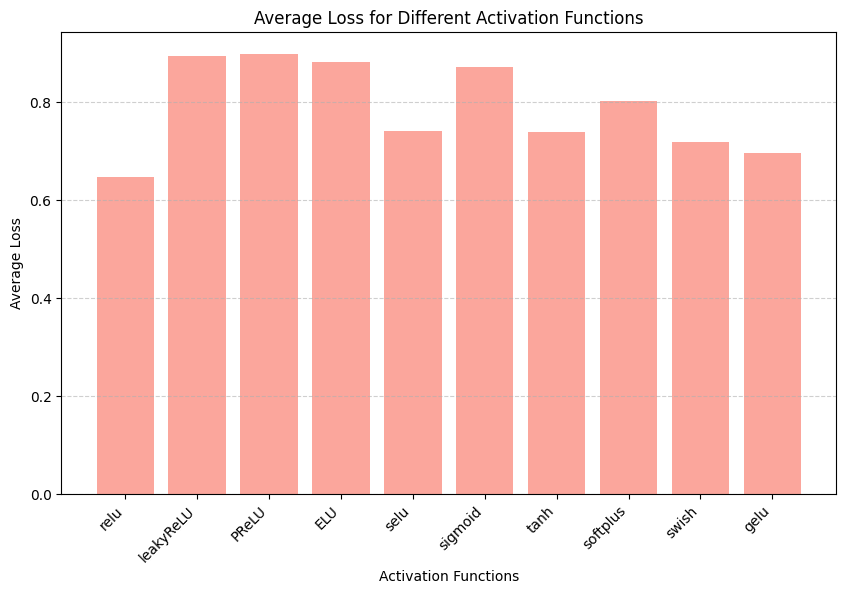

In [30]:
activation_functions = [
    'relu',                      # ReLU
    tf.keras.layers.LeakyReLU(), # Leaky ReLU (Layer instance)
    tf.keras.layers.PReLU(),     # PReLU (Layer instance)
    tf.keras.layers.ELU(),       # ELU (Layer instance)
    'selu',                      # SELU
    'sigmoid',                   # Sigmoid
    'tanh',                      # Tanh
    'softplus',                  # Softplus
    'swish',                     # Swish
    'gelu'                       # GELU
]

k_fold_patterns = pd.concat([X_train_final, X_val_final], axis=0)
k_fold_labels = pd.concat([X_train_final['Type'], X_val_final['Type']], axis=0)
k = 10
kf = KFold(n_splits=k, shuffle=True, random_state=42)

accuracy_results_3 = [0 for _ in activation_functions]
loss_results_3 = [0 for _ in activation_functions]
std_accuracy_results_3 = [0 for _ in activation_functions]
std_loss_results_3 = [0 for _ in activation_functions]

for act_idx, activation_function in enumerate(activation_functions):
    print(f"Config: Activation_function={activation_function}")

    fold_accuracies_3 = []
    fold_loss_3 = []
    fold = 1

    for train_index, val_index in kf.split(k_fold_patterns):
        print(f"Training on fold {fold}...")

        X_train, X_val = k_fold_patterns.iloc[train_index].drop(columns=['Type']), k_fold_patterns.iloc[val_index].drop(columns=['Type'])
        y_train, y_val = k_fold_labels.iloc[train_index], k_fold_labels.iloc[val_index]

     
        hidden_activation = activation_function

        model_3, history_3, test_loss_3, test_accuracy_3 = build_model_k_fold(
            input_dim, output_dim, X_train.shape[0], 4, 2,
            hidden_activation, output_activation, loss_function, RpropOptimizer(), 310, 0.05, X_train, y_train, X_val, y_val)

        fold_accuracies_3.append(test_accuracy_3)
        fold_loss_3.append(test_loss_3)
        fold += 1

    avg_accuracy_3 = np.mean(fold_accuracies_3)
    std_accuracy_3 = np.std(fold_accuracies_3)
    accuracy_results_3[act_idx] = avg_accuracy_3
    std_accuracy_results_3[act_idx] = std_accuracy_3

    avg_loss_3 = np.mean(fold_loss_3)
    std_loss_3 = np.std(fold_loss_3)
    loss_results_3[act_idx] = avg_loss_3
    std_loss_results_3[act_idx] = std_loss_3

    print(f"Average Accuracy for config: Activation_function={activation_function}: {avg_accuracy_3:.4f}")

activation_functions_labels = [
    'relu',         
    'leakyReLU',
    'PReLU', 
    'ELU',
    'selu', 
    'sigmoid',
    'tanh',
    'softplus', 
    'swish',
    'gelu' 
]

# Bar plot for accuracy
plt.figure(figsize=(10, 6))
plt.bar([str(act) for act in activation_functions_labels], accuracy_results_3, color='skyblue', alpha=0.7)
plt.xlabel('Activation Functions')
plt.ylabel('Average Accuracy')
plt.title('Average Accuracy for Different Activation Functions')
plt.xticks(rotation=45, ha='right')
plt.grid(axis='y', linestyle='--', alpha=0.6)
plt.show()

# Bar plot for loss
plt.figure(figsize=(10, 6))
plt.bar([str(act) for act in activation_functions_labels], loss_results_3, color='salmon', alpha=0.7)
plt.xlabel('Activation Functions')
plt.ylabel('Average Loss')
plt.title('Average Loss for Different Activation Functions')
plt.xticks(rotation=45, ha='right')
plt.grid(axis='y', linestyle='--', alpha=0.6)
plt.show()


## Optimizer Hyperparameters

## Initial Step Size

Config: Initial_step_size=1e-06
Training on fold 1...
Using Mini-Batch Gradient Descent with a set proportion (batch size = 113)
Epoch 1/210
21/21 [==============================] - 1s 9ms/step - loss: 1.1705 - accuracy: 0.3759 - val_loss: 1.1539 - val_accuracy: 0.4427
Epoch 2/210
21/21 [==============================] - 0s 2ms/step - loss: 1.1640 - accuracy: 0.4059 - val_loss: 1.1537 - val_accuracy: 0.4427
Epoch 3/210
21/21 [==============================] - 0s 2ms/step - loss: 1.1650 - accuracy: 0.3874 - val_loss: 1.1534 - val_accuracy: 0.4427
Epoch 4/210
21/21 [==============================] - 0s 2ms/step - loss: 1.1633 - accuracy: 0.3944 - val_loss: 1.1532 - val_accuracy: 0.4427
Epoch 5/210
21/21 [==============================] - 0s 3ms/step - loss: 1.1608 - accuracy: 0.4046 - val_loss: 1.1530 - val_accuracy: 0.4427
Epoch 6/210
21/21 [==============================] - 0s 3ms/step - loss: 1.1674 - accuracy: 0.3839 - val_loss: 1.1528 - val_accuracy: 0.4427
Epoch 7/210
21/21 [======

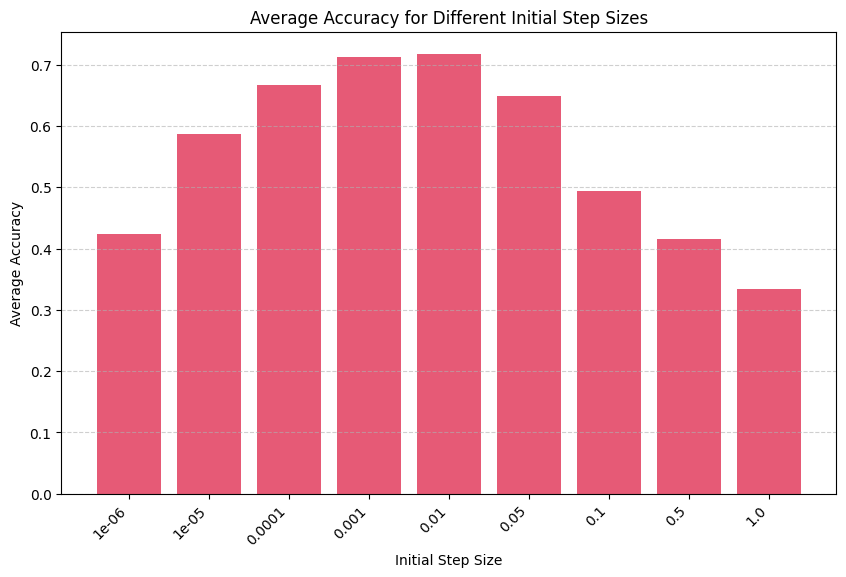

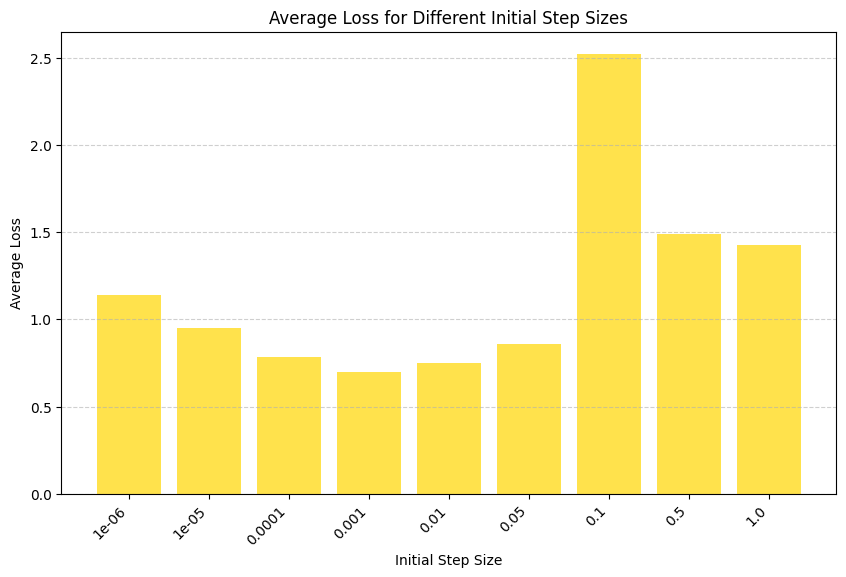

In [31]:
initial_step_size = [1e-6, 1e-5, 1e-4, 0.001, 0.01, 0.05, 0.1, 0.5, 1.0]

k_fold_patterns = pd.concat([X_train_final, X_val_final], axis=0)
k_fold_labels = pd.concat([X_train_final['Type'], X_val_final['Type']], axis=0)
k = 10
kf = KFold(n_splits=k, shuffle=True, random_state=42)

accuracy_results_4 = [0 for _ in initial_step_size]
loss_results_4 = [0 for _ in initial_step_size]
std_accuracy_results_4 = [0 for _ in initial_step_size]
std_loss_results_4 = [0 for _ in initial_step_size]

for step_idx, step_size in enumerate(initial_step_size):
    print(f"Config: Initial_step_size={step_size}")

    fold_accuracies_4 = []
    fold_loss_4 = []
    fold = 1

    for train_index, val_index in kf.split(k_fold_patterns):
        print(f"Training on fold {fold}...")

        X_train, X_val = k_fold_patterns.iloc[train_index].drop(columns=['Type']), k_fold_patterns.iloc[val_index].drop(columns=['Type'])
        y_train, y_val = k_fold_labels.iloc[train_index], k_fold_labels.iloc[val_index]


        model_4, history_4, test_loss_4, test_accuracy_4 = build_model_k_fold(
            input_dim, output_dim, X_train.shape[0], 4, 2,
            hidden_activation, output_activation, loss_function, RpropOptimizer2(step_size, 1.2, 0.5), 210, 0.05, X_train, y_train, X_val, y_val)

        fold_accuracies_4.append(test_accuracy_4)
        fold_loss_4.append(test_loss_4)
        fold += 1

    avg_accuracy_4 = np.mean(fold_accuracies_4)
    std_accuracy_4 = np.std(fold_accuracies_4)
    accuracy_results_4[step_idx] = avg_accuracy_4
    std_accuracy_results_4[step_idx] = std_accuracy_4

    avg_loss_4 = np.mean(fold_loss_4)
    std_loss_4 = np.std(fold_loss_4)
    loss_results_4[step_idx] = avg_loss_4
    std_loss_results_4[step_idx] = std_loss_4

    print(f"Average Accuracy for config: Initial_Step_Size={step_size}: {avg_accuracy_4:.4f}")

# Bar plot for accuracy
plt.figure(figsize=(10, 6))
plt.bar([str(act) for act in initial_step_size], accuracy_results_4, color='crimson', alpha=0.7)
plt.xlabel('Initial Step Size')
plt.ylabel('Average Accuracy')
plt.title('Average Accuracy for Different Initial Step Sizes')
plt.xticks(rotation=45, ha='right')
plt.grid(axis='y', linestyle='--', alpha=0.6)
plt.show()

# Bar plot for loss
plt.figure(figsize=(10, 6))
plt.bar([str(act) for act in initial_step_size], loss_results_4, color='gold', alpha=0.7)
plt.xlabel('Initial Step Size')
plt.ylabel('Average Loss')
plt.title('Average Loss for Different Initial Step Sizes')
plt.xticks(rotation=45, ha='right')
plt.grid(axis='y', linestyle='--', alpha=0.6)
plt.show()

## Fine Tuning Initial Step

Config: Initial_step_size=0.0003
Training on fold 1...
Using Mini-Batch Gradient Descent with a set proportion (batch size = 113)
Epoch 1/210
21/21 [==============================] - 2s 8ms/step - loss: 1.2116 - accuracy: 0.3244 - val_loss: 1.1483 - val_accuracy: 0.4229
Epoch 2/210
21/21 [==============================] - 0s 2ms/step - loss: 1.1173 - accuracy: 0.4619 - val_loss: 1.0790 - val_accuracy: 0.5731
Epoch 3/210
21/21 [==============================] - 0s 2ms/step - loss: 1.0691 - accuracy: 0.5104 - val_loss: 1.0363 - val_accuracy: 0.5968
Epoch 4/210
21/21 [==============================] - 0s 3ms/step - loss: 1.0308 - accuracy: 0.5518 - val_loss: 1.0062 - val_accuracy: 0.6245
Epoch 5/210
21/21 [==============================] - 0s 3ms/step - loss: 1.0076 - accuracy: 0.5527 - val_loss: 0.9818 - val_accuracy: 0.6324
Epoch 6/210
21/21 [==============================] - 0s 3ms/step - loss: 0.9936 - accuracy: 0.5531 - val_loss: 0.9610 - val_accuracy: 0.6285
Epoch 7/210
21/21 [=====

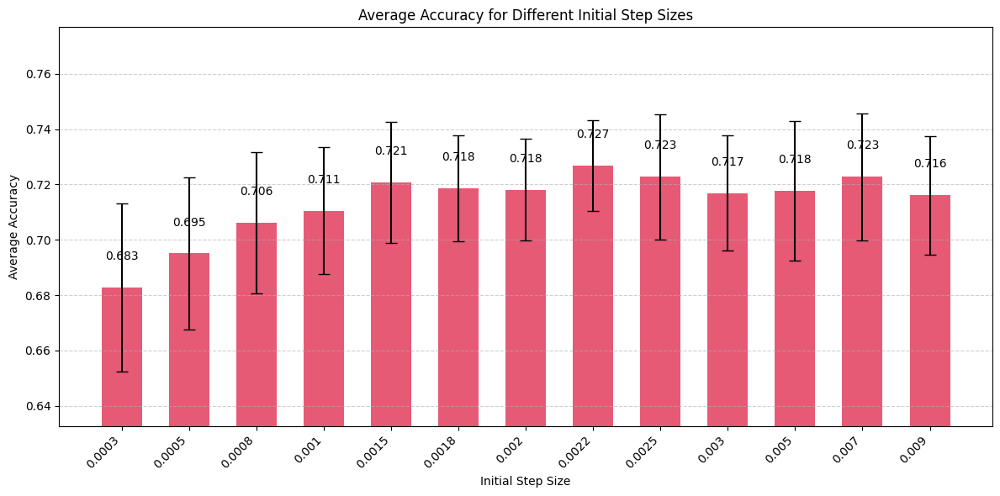

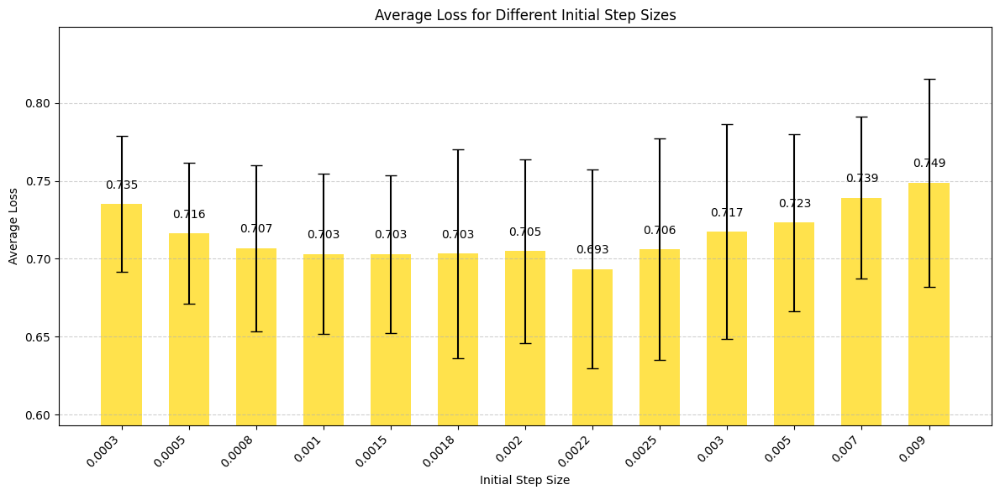

In [32]:
initial_step_size = [0.0003, 0.0005, 0.0008, 0.001,0.0015, 0.0018, 0.002, 0.0022, 0.0025, 0.003, 0.005, 0.007, 0.009]

k_fold_patterns = pd.concat([X_train_final, X_val_final], axis=0)
k_fold_labels = pd.concat([X_train_final['Type'], X_val_final['Type']], axis=0)
k = 10
kf = KFold(n_splits=k, shuffle=True, random_state=42)

accuracy_results_4 = [0 for _ in initial_step_size]
loss_results_4 = [0 for _ in initial_step_size]
std_accuracy_results_4 = [0 for _ in initial_step_size]
std_loss_results_4 = [0 for _ in initial_step_size]

for step_idx, step_size in enumerate(initial_step_size):
    print(f"Config: Initial_step_size={step_size}")

    fold_accuracies_4 = []
    fold_loss_4 = []
    fold = 1

    for train_index, val_index in kf.split(k_fold_patterns):
        print(f"Training on fold {fold}...")

        X_train, X_val = k_fold_patterns.iloc[train_index].drop(columns=['Type']), k_fold_patterns.iloc[val_index].drop(columns=['Type'])
        y_train, y_val = k_fold_labels.iloc[train_index], k_fold_labels.iloc[val_index]


        model_4, history_4, test_loss_4, test_accuracy_4 = build_model_k_fold(
            input_dim, output_dim, X_train.shape[0], 4, 2,
            hidden_activation, output_activation, loss_function, RpropOptimizer2(step_size, 1.2, 0.5), 210, 0.05, X_train, y_train, X_val, y_val)

        fold_accuracies_4.append(test_accuracy_4)
        fold_loss_4.append(test_loss_4)
        fold += 1

    avg_accuracy_4 = np.mean(fold_accuracies_4)
    std_accuracy_4 = np.std(fold_accuracies_4)
    accuracy_results_4[step_idx] = avg_accuracy_4
    std_accuracy_results_4[step_idx] = std_accuracy_4

    avg_loss_4 = np.mean(fold_loss_4)
    std_loss_4 = np.std(fold_loss_4)
    loss_results_4[step_idx] = avg_loss_4
    std_loss_results_4[step_idx] = std_loss_4

    print(f"Average Accuracy for config: Initial_Step_Size={step_size}: {avg_accuracy_4:.4f}")

plt.figure(figsize=(12, 6))
plt.bar(
    [str(step) for step in initial_step_size], 
    accuracy_results_4, 
    color='crimson', 
    alpha=0.7, 
    width=0.6,
    yerr=std_accuracy_results_4,
    capsize=5,
    error_kw=dict(ecolor='black', lw=1.5)
)
plt.xlabel('Initial Step Size')
plt.ylabel('Average Accuracy')
plt.ylim([min(accuracy_results_4) - 0.05, max(accuracy_results_4) + 0.05])
plt.title('Average Accuracy for Different Initial Step Sizes')
plt.xticks(rotation=45, ha='right')

for idx, value in enumerate(accuracy_results_4):
    plt.text(idx, value + 0.01, f'{value:.3f}', ha='center', fontsize=10, color='black')

plt.grid(axis='y', linestyle='--', alpha=0.6)
plt.tight_layout()
plt.show()

plt.figure(figsize=(12, 6))
plt.bar(
    [str(step) for step in initial_step_size], 
    loss_results_4, 
    color='gold', 
    alpha=0.7, 
    width=0.6,
    yerr=std_loss_results_4,
    capsize=5,
    error_kw=dict(ecolor='black', lw=1.5)
)
plt.xlabel('Initial Step Size')
plt.ylabel('Average Loss')
plt.ylim([min(loss_results_4) - 0.1, max(loss_results_4) + 0.1])
plt.title('Average Loss for Different Initial Step Sizes')
plt.xticks(rotation=45, ha='right')

for idx, value in enumerate(loss_results_4):
    plt.text(idx, value + 0.01, f'{value:.3f}', ha='center', fontsize=10, color='black')

plt.grid(axis='y', linestyle='--', alpha=0.6)
plt.tight_layout()
plt.show()

## Increase Factor and Decrease Factor


Config: Increase Factors=1.1, Decrease Factor=0.1
Training on fold 1...
Using Mini-Batch Gradient Descent with a set proportion (batch size = 108)
Epoch 1/150
21/21 [==============================] - 1s 9ms/step - loss: 1.0614 - accuracy: 0.4947 - val_loss: 0.9482 - val_accuracy: 0.5762
Epoch 2/150
21/21 [==============================] - 0s 2ms/step - loss: 0.9503 - accuracy: 0.5692 - val_loss: 0.8824 - val_accuracy: 0.6233
Epoch 3/150
21/21 [==============================] - 0s 2ms/step - loss: 0.9013 - accuracy: 0.6011 - val_loss: 0.8450 - val_accuracy: 0.6537
Epoch 4/150
21/21 [==============================] - 0s 2ms/step - loss: 0.8648 - accuracy: 0.6242 - val_loss: 0.8276 - val_accuracy: 0.6593
Epoch 5/150
21/21 [==============================] - 0s 2ms/step - loss: 0.8481 - accuracy: 0.6280 - val_loss: 0.8135 - val_accuracy: 0.6648
Epoch 6/150
21/21 [==============================] - 0s 2ms/step - loss: 0.8308 - accuracy: 0.6428 - val_loss: 0.8048 - val_accuracy: 0.6759
Epoch 7

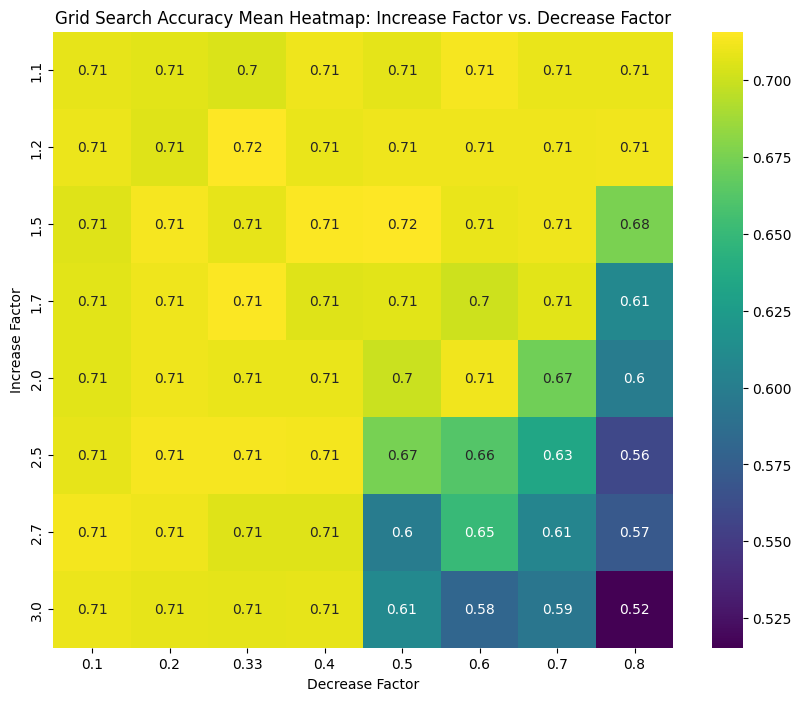

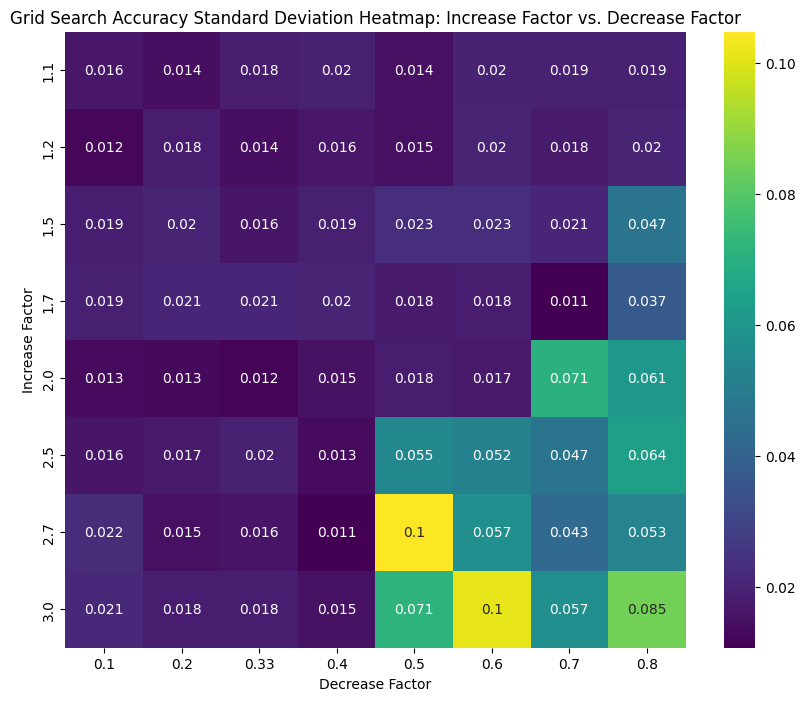

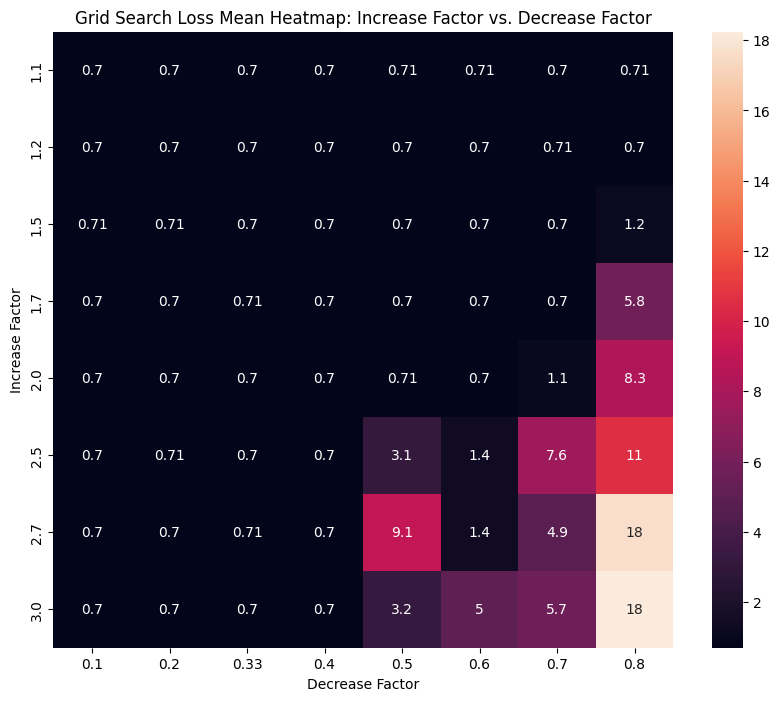

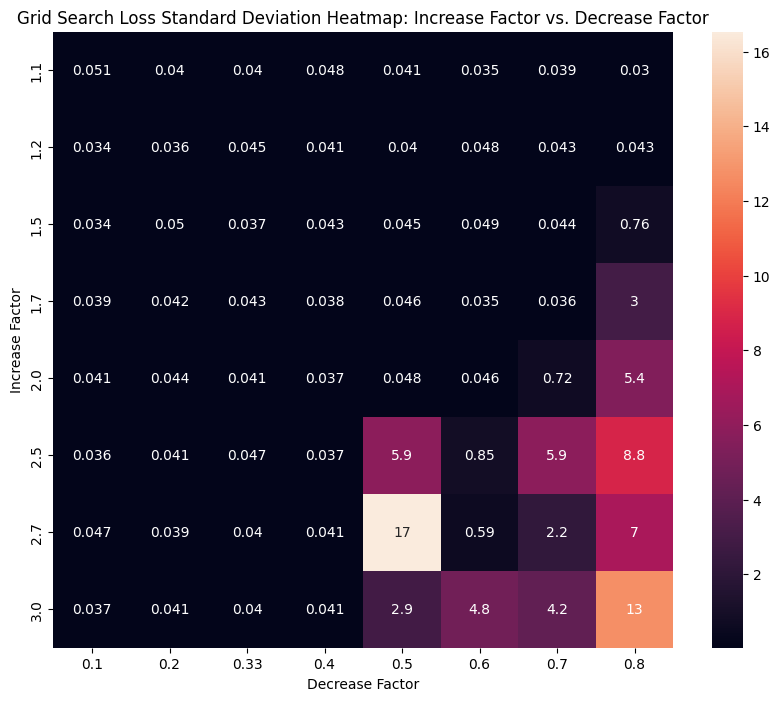

In [33]:
k_fold_patterns = pd.concat([X_train_final, X_val_final], axis=0)
k_fold_labels = pd.concat([X_train_final['Type'], X_val_final['Type']], axis=0)
k = 7
kf = KFold(n_splits=k, shuffle=True, random_state=42)

increase_factors_values = [1.1, 1.2, 1.5, 1.7, 2.0, 2.5, 2.7, 3.0]
decrease_factors_values = [0.1, 0.2, 0.33, 0.4, 0.5, 0.6, 0.7, 0.8]

accuracy_results_5 = [[0 for _ in decrease_factors_values] for _ in increase_factors_values]
loss_results_5 = [[0 for _ in decrease_factors_values] for _ in increase_factors_values]
std_accuracy_results_5 = [[0 for _ in decrease_factors_values] for _ in increase_factors_values]
std_loss_results_5 = [[0 for _ in decrease_factors_values] for _ in increase_factors_values]

for inc_idx, increase in enumerate(increase_factors_values):
    for dec_idx, decrease in enumerate(decrease_factors_values):

        print(f"Config: Increase Factors={increase}, Decrease Factor={decrease}")

        fold_accuracies_5 = []
        fold_loss_5 = []
        fold = 1

        for train_index, val_index in kf.split(k_fold_patterns):
            print(f"Training on fold {fold}...")

            X_train, X_val = k_fold_patterns.iloc[train_index].drop(columns=['Type']), k_fold_patterns.iloc[val_index].drop(columns=['Type'])
            y_train, y_val = k_fold_labels.iloc[train_index], k_fold_labels.iloc[val_index]


            model_5 ,history_5 , test_loss_5 , test_accuracy_5  = build_model_k_fold(
                    input_dim, output_dim, X_train.shape[0], 4, 2,
                    hidden_activation, output_activation, loss_function, RpropOptimizer2(0.0022, increase, decrease), 150, 0.05, X_train, y_train, X_val, y_val)

            fold_accuracies_5.append(test_accuracy_5)
            fold_loss_5.append(test_loss_5)
            fold += 1

      
        avg_accuracy_5 = np.mean(fold_accuracies_5)
        std_accuracy_5 = np.std(fold_accuracies_5)
        accuracy_results_5[inc_idx][dec_idx] = avg_accuracy_5
        std_accuracy_results_5[inc_idx][dec_idx] = std_accuracy_5
        

        avg_loss_5 = np.mean(fold_loss_5)
        std_loss_5 = np.std(fold_loss_5)
        loss_results_5[inc_idx][dec_idx] = avg_loss_5
        std_loss_results_5[inc_idx][dec_idx] = std_loss_5

        print(f"Average Accuracy for config: Increase Factor={increase}, Decrease Factor={decrease}: {avg_accuracy_5:.4f}")

accuracy_array_5 = np.array(accuracy_results_5)

plt.figure(figsize=(10, 8))
ax = sns.heatmap(accuracy_array_5, annot=True, cmap="viridis", xticklabels=decrease_factors_values, yticklabels=increase_factors_values)

ax.set_xlabel("Decrease Factor")
ax.set_ylabel("Increase Factor")
ax.set_title("Grid Search Accuracy Mean Heatmap: Increase Factor vs. Decrease Factor")

plt.show()

std_accuracy_array_5 = np.array(std_accuracy_results_5)

plt.figure(figsize=(10, 8))
ax = sns.heatmap(std_accuracy_array_5, annot=True, cmap="viridis", xticklabels=decrease_factors_values, yticklabels=increase_factors_values)

ax.set_xlabel("Decrease Factor")
ax.set_ylabel("Increase Factor")
ax.set_title("Grid Search Accuracy Standard Deviation Heatmap: Increase Factor vs. Decrease Factor")

plt.show()

loss_array_5 = np.array(loss_results_5)

plt.figure(figsize=(10, 8))
ax = sns.heatmap(loss_array_5, annot=True, xticklabels=decrease_factors_values, yticklabels=increase_factors_values)

ax.set_xlabel("Decrease Factor")
ax.set_ylabel("Increase Factor")
ax.set_title("Grid Search Loss Mean Heatmap: Increase Factor vs. Decrease Factor")

plt.show()

std_loss_array_5 = np.array(std_loss_results_5)

plt.figure(figsize=(10, 8))
ax = sns.heatmap(std_loss_array_5, annot=True, xticklabels=decrease_factors_values, yticklabels=increase_factors_values)

ax.set_xlabel("Decrease Factor")
ax.set_ylabel("Increase Factor")
ax.set_title("Grid Search Loss Standard Deviation Heatmap: Increase Factor vs. Decrease Factor")

plt.show()

## Tuned Hyperparameters

In [34]:
input_dim = X_train_final.shape[1] - 1
output_dim = 3
hidden_neuron_factor = X_train_final.shape[0]
Hidden_Neuron = int(X_train_final.shape[0]/(input_dim + output_dim))
hidden_activation = 'relu'
output_activation = 'softmax'
loss_function = 'sparse_categorical_crossentropy'
epochs = 210
hidden_neutron_ratio = 4
hidden_layers = 2
batch_size = 0.05
initial_step_size = 0.0022
increase_factor = 2.7
decrease_factor = 0.33
X_train = X_train_final.drop(columns=['Type'])
y_train = X_train_final['Type']
X_val = X_val_final.drop(columns=['Type'])
y_val = X_val_final['Type']
X_test = X_test_final.drop(columns=['Type'])
y_test = X_test_final['Type']


Using Mini-Batch Gradient Descent with a set proportion (batch size = 98)
Epoch 1/210
21/21 [==============================] - 1s 8ms/step - loss: 1.0836 - accuracy: 0.4715 - val_loss: 0.9666 - val_accuracy: 0.5554
Epoch 2/210
21/21 [==============================] - 0s 2ms/step - loss: 0.9455 - accuracy: 0.5744 - val_loss: 0.8787 - val_accuracy: 0.6214
Epoch 3/210
21/21 [==============================] - 0s 2ms/step - loss: 0.8972 - accuracy: 0.5963 - val_loss: 0.8603 - val_accuracy: 0.6375
Epoch 4/210
21/21 [==============================] - 0s 2ms/step - loss: 0.8427 - accuracy: 0.6366 - val_loss: 0.8352 - val_accuracy: 0.6375
Epoch 5/210
21/21 [==============================] - 0s 2ms/step - loss: 0.8260 - accuracy: 0.6453 - val_loss: 0.8262 - val_accuracy: 0.6464
Epoch 6/210
21/21 [==============================] - 0s 2ms/step - loss: 0.8018 - accuracy: 0.6509 - val_loss: 0.8122 - val_accuracy: 0.6339
Epoch 7/210
21/21 [==============================] - 0s 2ms/step - loss: 0.7919 

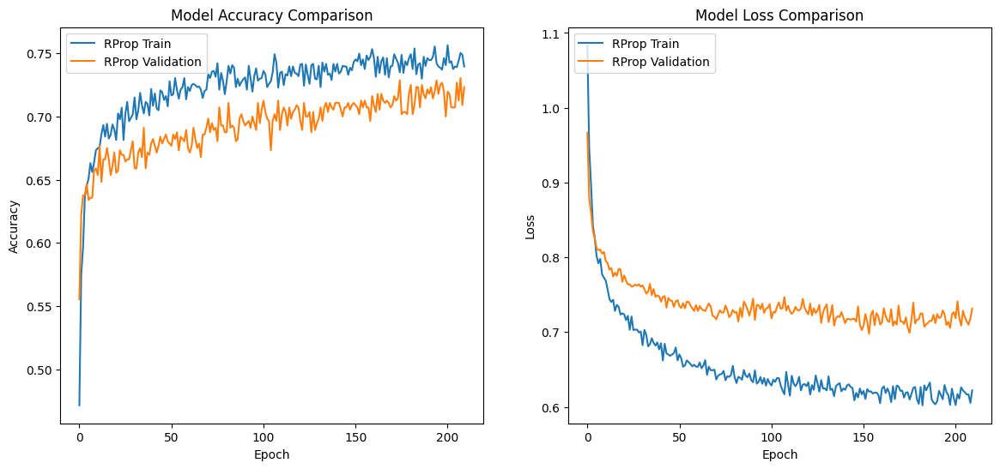

18/18 [==============================] - 0s 784us/step


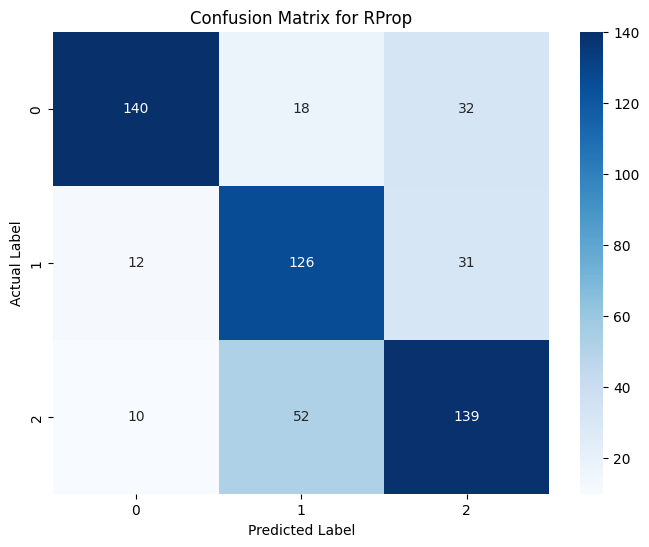

In [35]:
model_6 ,history_6 , test_loss_6 , test_accuracy_6  = build_model_k_fold(
            input_dim, output_dim, X_train.shape[0], hidden_neutron_ratio, hidden_layers,
            hidden_activation, output_activation, loss_function, RpropOptimizer2(initial_step_size, increase_factor, decrease_factor), epochs, batch_size, X_train, y_train, X_val, y_val)

histories = [history_6]
labels = ['RProp']
plot_combined_metrics(histories, labels)
plot_confusion_matrix(model_6, X_val, y_val, 'RProp')


### Final Test: Validation

9/9 [==============================] - 0s 1ms/step


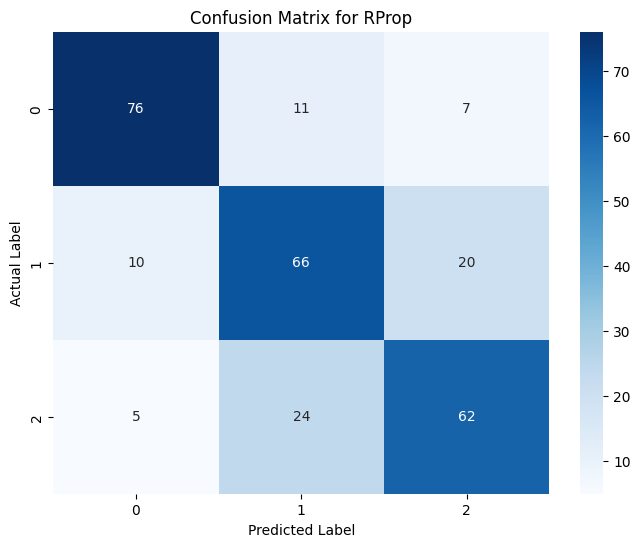

In [36]:
test_loss, test_accuracy = model_6.evaluate(X_test, y_test, verbose=1)
plot_confusion_matrix(model_6, X_test, y_test, 'RProp')

# Hybrid Learning Section

In [59]:
model_RProp ,history_RProp , test_loss_RProp , test_accuracy_RProp  = build_model_k_fold(
            input_dim, output_dim, X_train.shape[0], hidden_neutron_ratio, hidden_layers,
            hidden_activation, output_activation, loss_function, RpropOptimizer2(initial_step_size, increase_factor, decrease_factor), epochs, batch_size, X_train, y_train, X_val, y_val)

model_Adam ,history_Adam , test_loss_Adam , test_accuracy_Adam  = build_model_k_fold(
            input_dim, output_dim, X_train.shape[0], hidden_neutron_ratio, hidden_layers,
            hidden_activation, output_activation, loss_function, 'Adam', epochs, batch_size, X_train, y_train, X_val, y_val)

model_amsgrad ,history_amsgrad , test_loss_amsgrad , test_accuracy_amsgrad  = build_model_k_fold(
            input_dim, output_dim, X_train.shape[0], hidden_neutron_ratio, hidden_layers,
            hidden_activation, output_activation, loss_function, Adam(amsgrad=True), epochs, batch_size, X_train, y_train, X_val, y_val)

model_Hydrid ,history_Hydrid , test_loss_Hydrid , test_accuracy_Hydrid  = build_model_k_fold(
            input_dim, output_dim, X_train.shape[0], hidden_neutron_ratio, hidden_layers,
            hidden_activation, output_activation, loss_function, HydridAMSGradRPropOptimizer(0.5), epochs, batch_size, X_train, y_train, X_val, y_val)

Using Mini-Batch Gradient Descent with a set proportion (batch size = 126)
Epoch 1/210
21/21 [==============================] - 1s 11ms/step - loss: 1.0430 - accuracy: 0.5379 - val_loss: 0.9615 - val_accuracy: 0.6179
Epoch 2/210
21/21 [==============================] - 0s 5ms/step - loss: 0.9306 - accuracy: 0.6068 - val_loss: 0.8734 - val_accuracy: 0.6250
Epoch 3/210
21/21 [==============================] - 0s 5ms/step - loss: 0.8802 - accuracy: 0.6290 - val_loss: 0.8197 - val_accuracy: 0.6857
Epoch 4/210
21/21 [==============================] - 0s 5ms/step - loss: 0.8611 - accuracy: 0.6429 - val_loss: 0.8174 - val_accuracy: 0.6500
Epoch 5/210
21/21 [==============================] - 0s 5ms/step - loss: 0.8331 - accuracy: 0.6476 - val_loss: 0.7792 - val_accuracy: 0.6607
Epoch 6/210
21/21 [==============================] - 0s 5ms/step - loss: 0.8222 - accuracy: 0.6587 - val_loss: 0.7713 - val_accuracy: 0.6786
Epoch 7/210
21/21 [==============================] - 0s 5ms/step - loss: 0.816

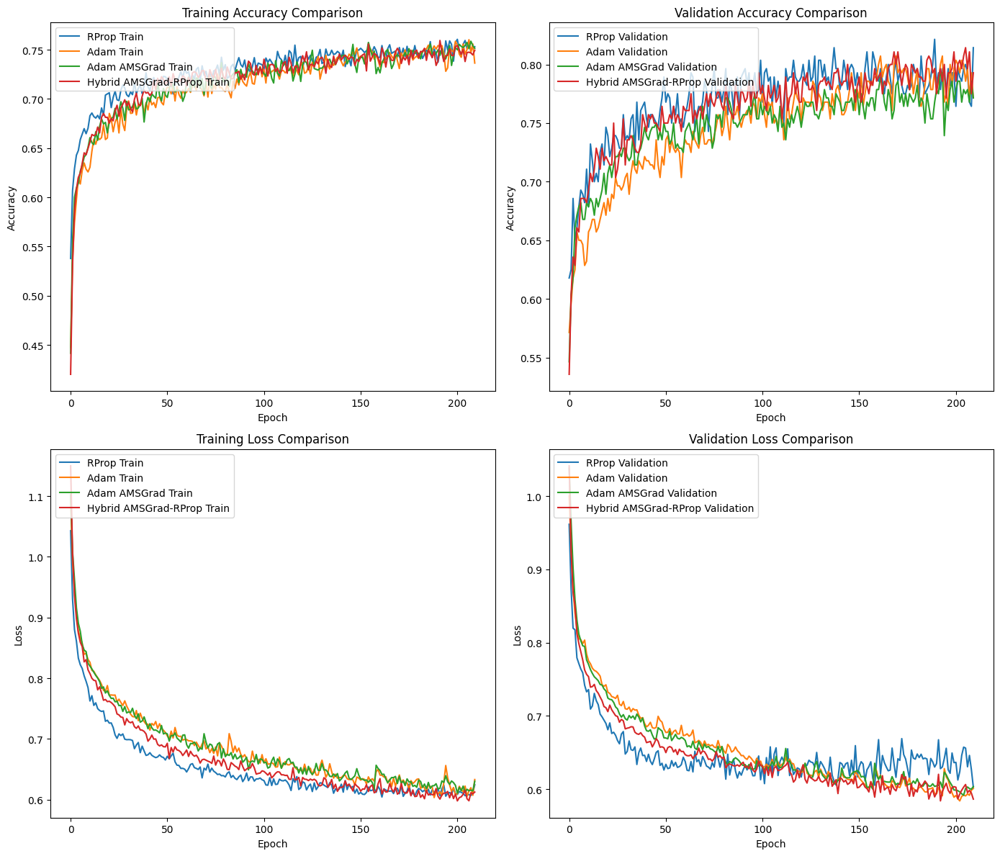

9/9 [==============================] - 0s 2ms/step


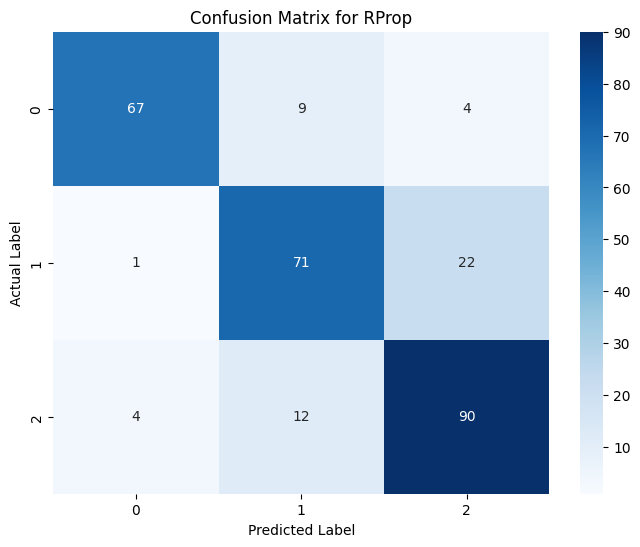

9/9 [==============================] - 0s 1ms/step


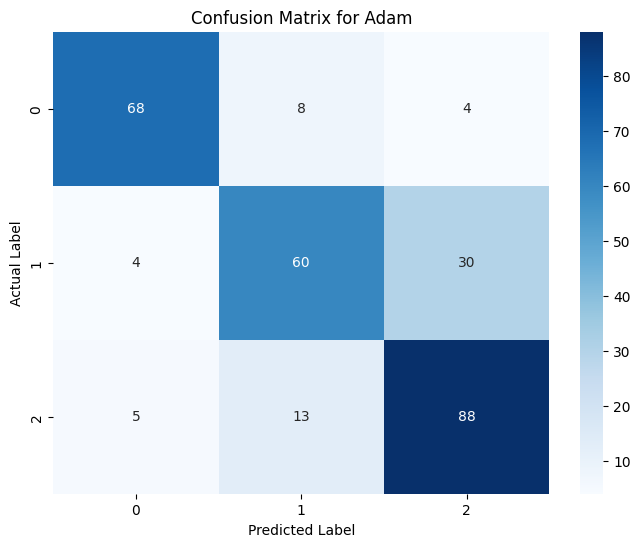

9/9 [==============================] - 0s 1ms/step


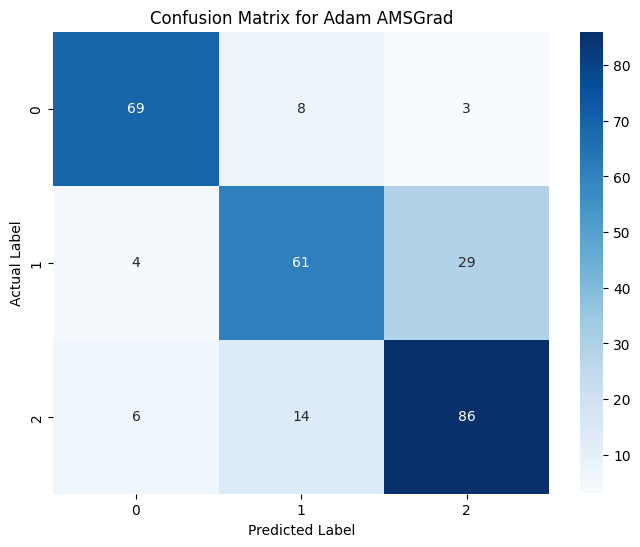

9/9 [==============================] - 0s 1ms/step


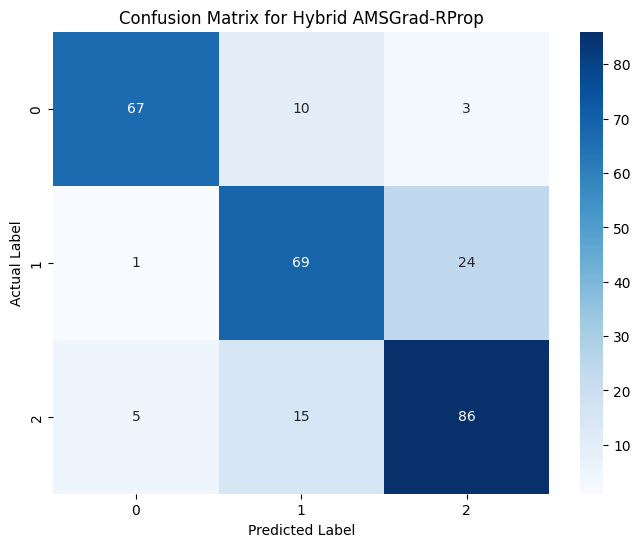

In [60]:
histories = [history_RProp, history_Adam, history_amsgrad, history_Hydrid]
labels = ['RProp','Adam', 'Adam AMSGrad', 'Hybrid AMSGrad-RProp']
plot_split_metrics(histories, labels)
plot_confusion_matrix(model_RProp, X_val, y_val, 'RProp')
plot_confusion_matrix(model_Adam, X_val, y_val, 'Adam')
plot_confusion_matrix(model_amsgrad, X_val, y_val, 'Adam AMSGrad')
plot_confusion_matrix(model_Hydrid, X_val, y_val, 'Hybrid AMSGrad-RProp')

In [72]:
model_RProp ,history_RProp , test_loss_RProp , test_accuracy_RProp, gradient_RProp  = build_model_k_fold_callback(
            input_dim, output_dim, X_train.shape[0], hidden_neutron_ratio, hidden_layers,
            hidden_activation, output_activation, loss_function, RpropOptimizer2(initial_step_size, increase_factor, decrease_factor), epochs, batch_size, X_train, y_train, X_val, y_val)

model_Adam ,history_Adam , test_loss_Adam , test_accuracy_Adam, gradient_Adam  = build_model_k_fold_callback(
            input_dim, output_dim, X_train.shape[0], hidden_neutron_ratio, hidden_layers,
            hidden_activation, output_activation, loss_function, 'Adam', epochs, batch_size, X_train, y_train, X_val, y_val)

model_amsgrad ,history_amsgrad , test_loss_amsgrad , test_accuracy_amsgrad, gradient_amsgrad  = build_model_k_fold_callback(
            input_dim, output_dim, X_train.shape[0], hidden_neutron_ratio, hidden_layers,
            hidden_activation, output_activation, loss_function, Adam(amsgrad=True), epochs, batch_size, X_train, y_train, X_val, y_val)

model_Hydrid ,history_Hydrid , test_loss_Hydrid , test_accuracy_Hydrid, gradient_Hybrid  = build_model_k_fold_callback(
            input_dim, output_dim, X_train.shape[0], hidden_neutron_ratio, hidden_layers,
            hidden_activation, output_activation, loss_function, HydridAMSGradRPropOptimizer(0.5), epochs, batch_size, X_train, y_train, X_val, y_val)

Using Mini-Batch Gradient Descent with a set proportion (batch size = 126)
Epoch 1/210
Batch 0, Gradient Norm: 0.13754336535930634
 6/21 [=======>......................] - ETA: 0s - loss: 1.0420 - accuracy: 0.4511WARNING:tensorflow:Callback method `on_train_batch_end` is slow compared to the batch time (batch time: 0.0054s vs `on_train_batch_end` time: 0.0513s). Check your callbacks.
Batch 6, Gradient Norm: 0.0752701684832573
21/21 [==============================] - 2s 62ms/step - loss: 0.9699 - accuracy: 0.4911 - val_loss: 0.9748 - val_accuracy: 0.5929
Epoch 2/210
Batch 0, Gradient Norm: 0.06686359643936157
21/21 [==============================] - 1s 55ms/step - loss: 0.8637 - accuracy: 0.5787 - val_loss: 0.8633 - val_accuracy: 0.6179
Epoch 3/210
Batch 0, Gradient Norm: 0.05977964401245117
21/21 [==============================] - 1s 55ms/step - loss: 0.8107 - accuracy: 0.6120 - val_loss: 0.8136 - val_accuracy: 0.6571
Epoch 4/210
Batch 0, Gradient Norm: 0.08069166541099548
 8/21 [=====

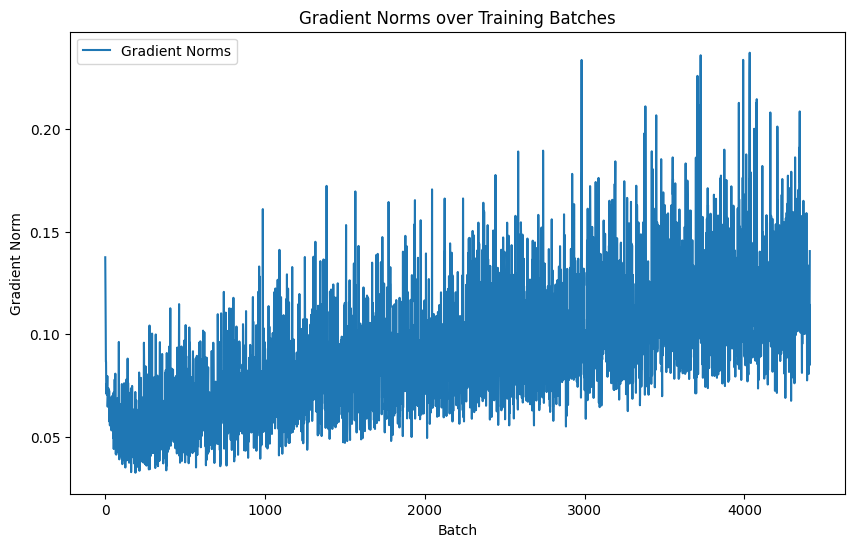

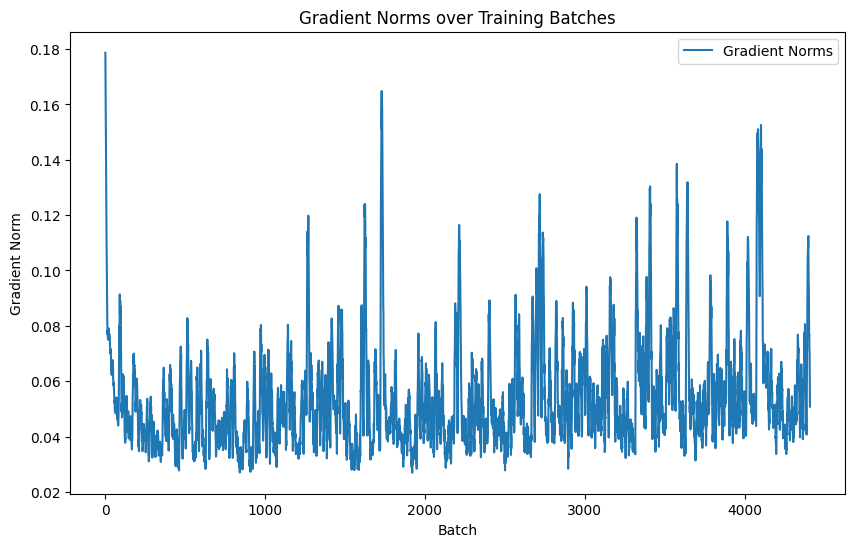

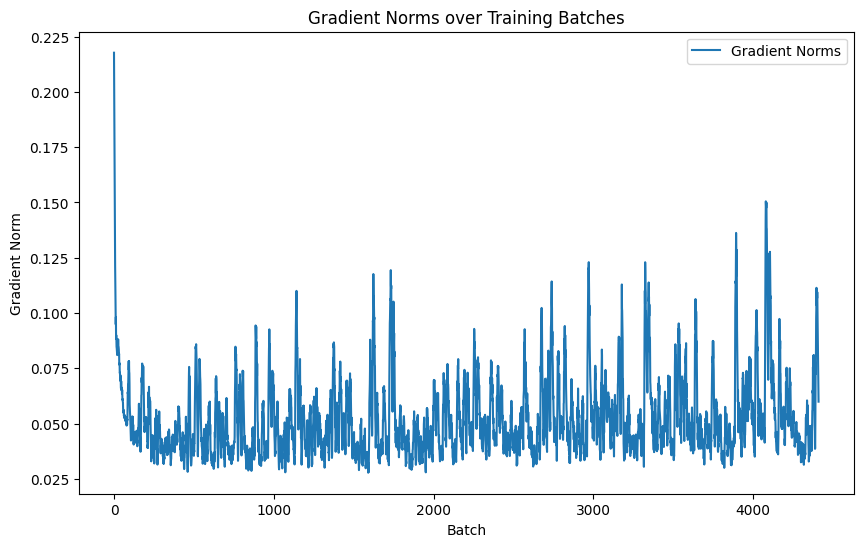

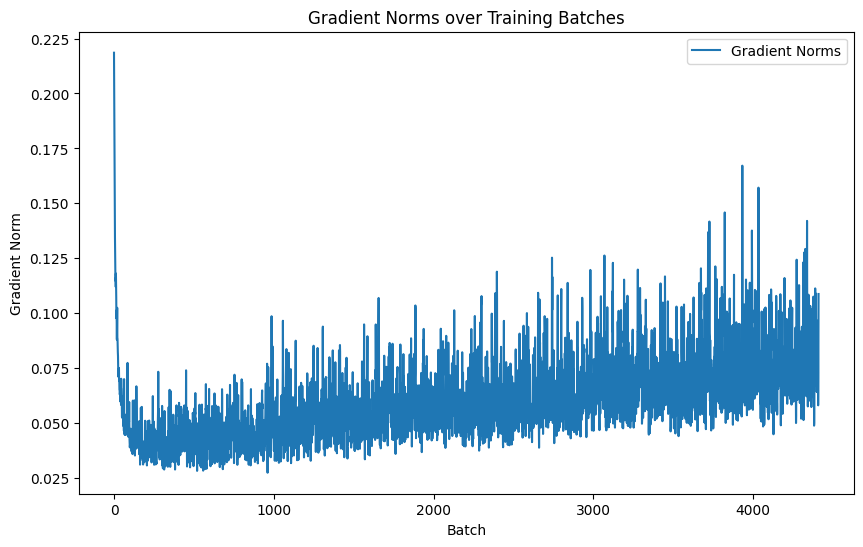

In [73]:
plot_gradient_norms(gradient_RProp.gradient_norms)
plot_gradient_norms(gradient_Adam.gradient_norms)
plot_gradient_norms(gradient_amsgrad.gradient_norms)
plot_gradient_norms(gradient_Hybrid.gradient_norms)

In [65]:
model_RProp ,history_RProp , test_loss_RProp , test_accuracy_RProp  = build_model_k_fold(
            input_dim, output_dim, X_train.shape[0], hidden_neutron_ratio, hidden_layers,
            hidden_activation, output_activation, loss_function, RpropOptimizer3(initial_step_size, 2.0, decrease_factor), epochs, batch_size, X_train, y_train, X_val, y_val)

model_Adam ,history_Adam , test_loss_Adam , test_accuracy_Adam  = build_model_k_fold(
            input_dim, output_dim, X_train.shape[0], hidden_neutron_ratio, hidden_layers,
            hidden_activation, output_activation, loss_function, Adam(clipnorm=3.0), epochs, batch_size, X_train, y_train, X_val, y_val)

model_amsgrad ,history_amsgrad , test_loss_amsgrad , test_accuracy_amsgrad  = build_model_k_fold(
            input_dim, output_dim, X_train.shape[0], hidden_neutron_ratio, hidden_layers,
            hidden_activation, output_activation, loss_function, Adam(amsgrad=True, clipnorm=3.0), epochs, batch_size, X_train, y_train, X_val, y_val)

model_Hydrid ,history_Hydrid , test_loss_Hydrid , test_accuracy_Hydrid  = build_model_k_fold(
            input_dim, output_dim, X_train.shape[0], hidden_neutron_ratio, hidden_layers,
            hidden_activation, output_activation, loss_function, HydridAMSGradRPropOptimizer(0.5), epochs, batch_size, X_train, y_train, X_val, y_val)

Using Mini-Batch Gradient Descent with a set proportion (batch size = 126)
Epoch 1/210
21/21 [==============================] - 1s 11ms/step - loss: 1.0834 - accuracy: 0.4721 - val_loss: 0.9803 - val_accuracy: 0.5964
Epoch 2/210
21/21 [==============================] - 0s 5ms/step - loss: 0.9365 - accuracy: 0.5929 - val_loss: 0.8701 - val_accuracy: 0.6107
Epoch 3/210
21/21 [==============================] - 0s 5ms/step - loss: 0.8914 - accuracy: 0.6147 - val_loss: 0.8162 - val_accuracy: 0.6357
Epoch 4/210
21/21 [==============================] - 0s 5ms/step - loss: 0.8571 - accuracy: 0.6294 - val_loss: 0.8141 - val_accuracy: 0.6607
Epoch 5/210
21/21 [==============================] - 0s 5ms/step - loss: 0.8384 - accuracy: 0.6393 - val_loss: 0.7696 - val_accuracy: 0.6893
Epoch 6/210
21/21 [==============================] - 0s 5ms/step - loss: 0.8157 - accuracy: 0.6683 - val_loss: 0.7555 - val_accuracy: 0.6786
Epoch 7/210
21/21 [==============================] - 0s 5ms/step - loss: 0.801

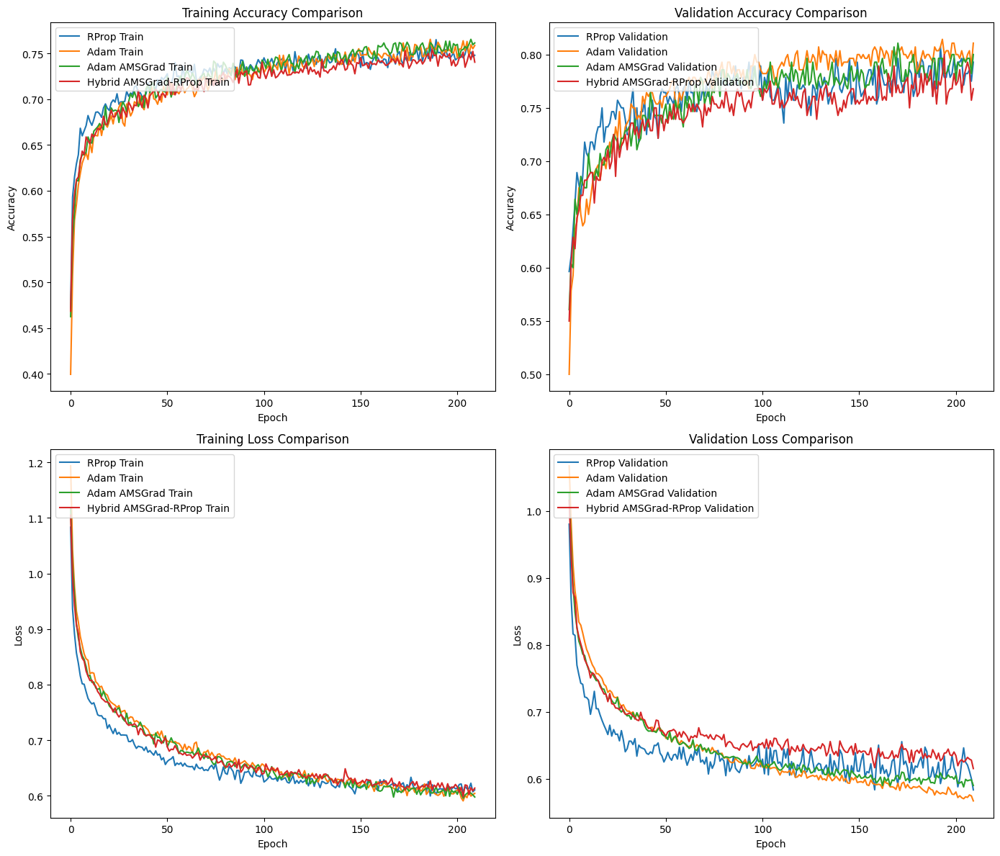

9/9 [==============================] - 0s 1ms/step


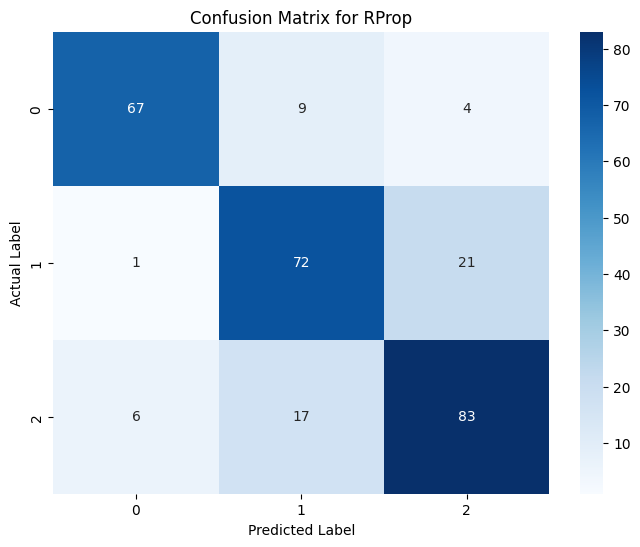

9/9 [==============================] - 0s 1ms/step


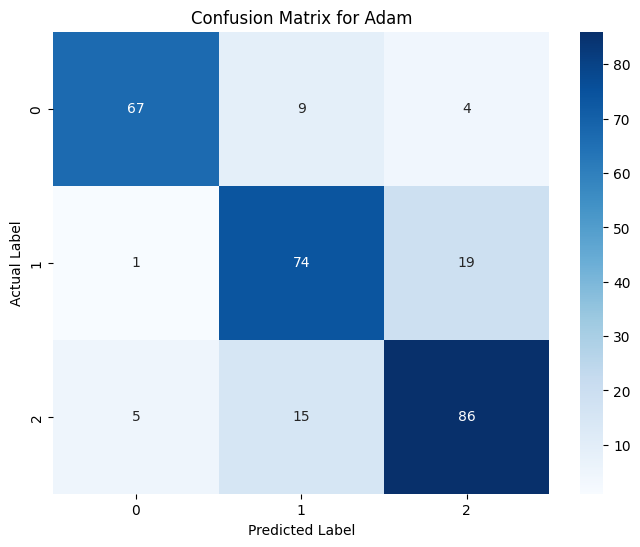

9/9 [==============================] - 0s 1ms/step


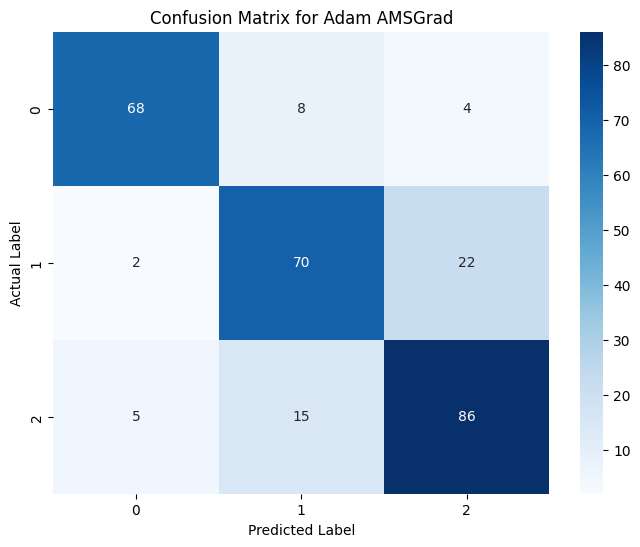

9/9 [==============================] - 0s 1ms/step


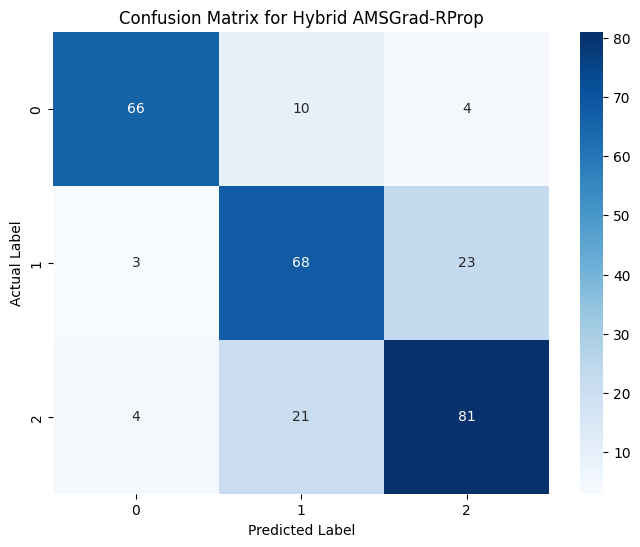

In [66]:
histories = [history_RProp, history_Adam, history_amsgrad, history_Hydrid]
labels = ['RProp','Adam', 'Adam AMSGrad', 'Hybrid AMSGrad-RProp']
plot_split_metrics(histories, labels)
plot_confusion_matrix(model_RProp, X_val, y_val, 'RProp')
plot_confusion_matrix(model_Adam, X_val, y_val, 'Adam')
plot_confusion_matrix(model_amsgrad, X_val, y_val, 'Adam AMSGrad')
plot_confusion_matrix(model_Hydrid, X_val, y_val, 'Hybrid AMSGrad-RProp')

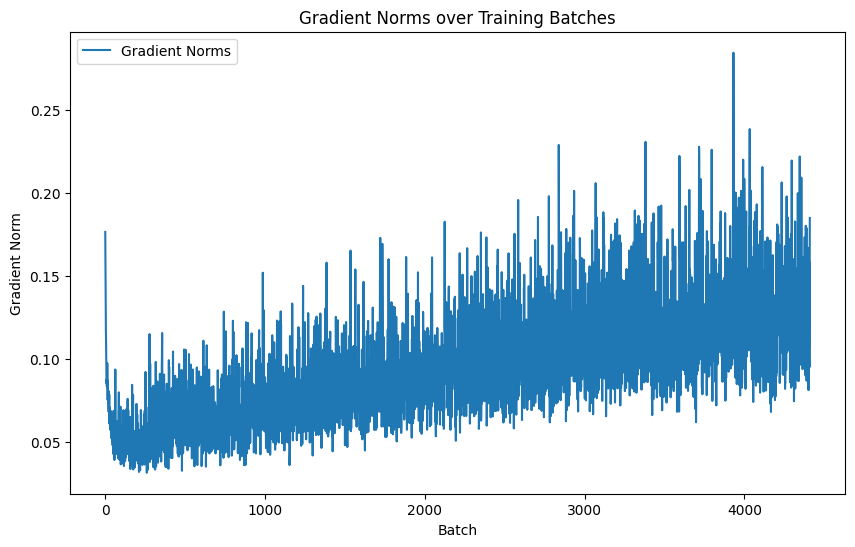

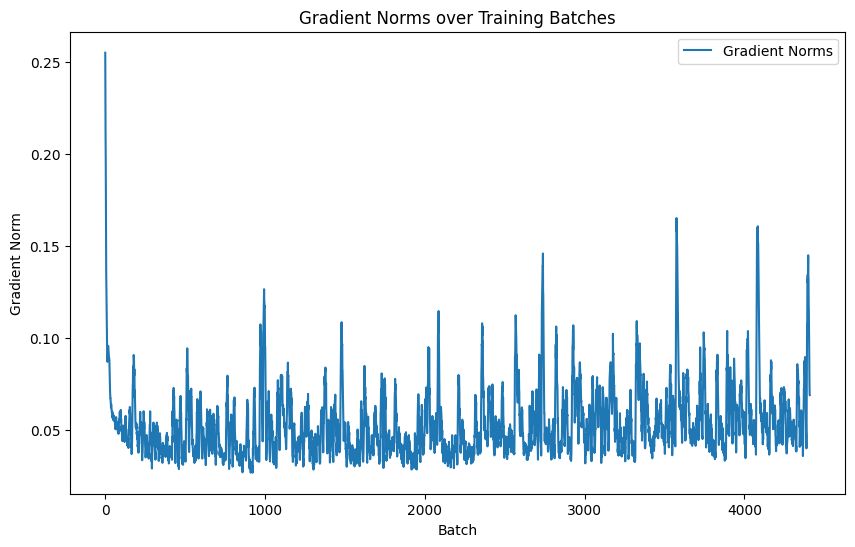

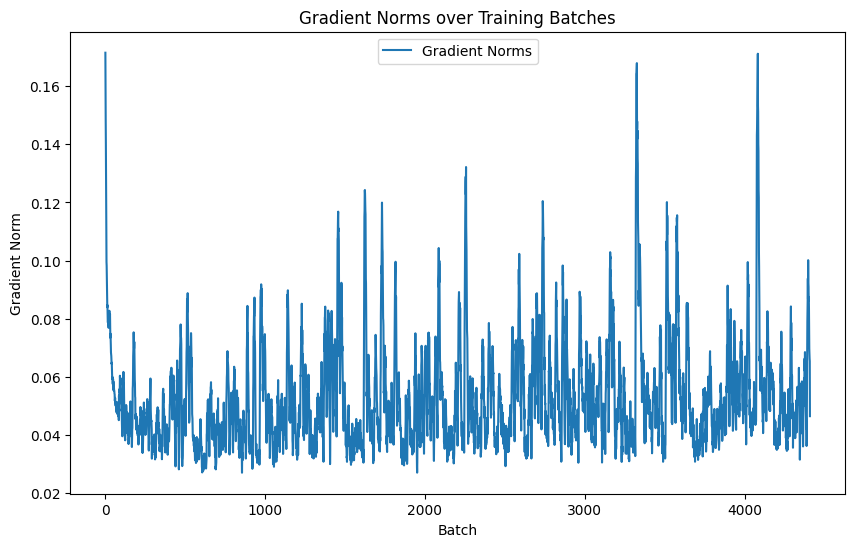

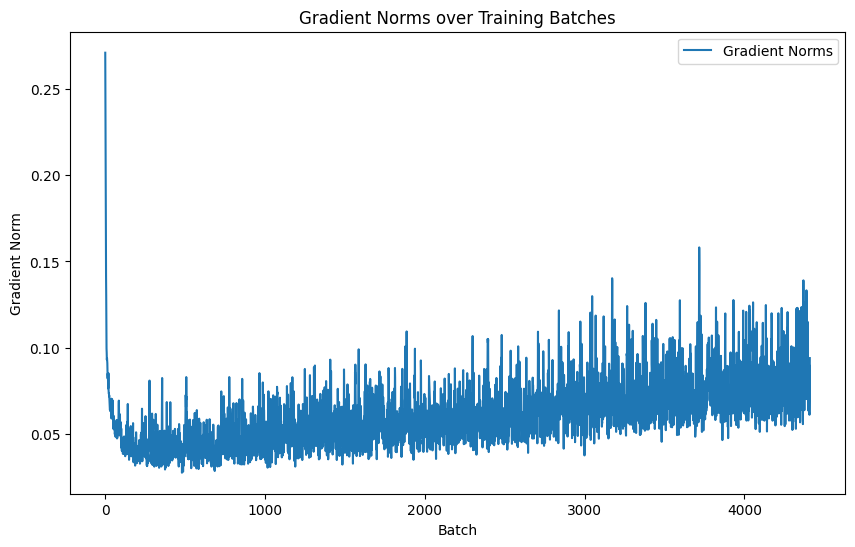

In [68]:
plot_gradient_norms(gradient_RProp.gradient_norms)
plot_gradient_norms(gradient_Adam.gradient_norms)
plot_gradient_norms(gradient_amsgrad.gradient_norms)
plot_gradient_norms(gradient_Hybrid.gradient_norms)

In [56]:
k_fold_patterns = pd.concat([X_train_final, X_val_final, X_test_final], axis=0)
k_fold_labels = pd.concat([X_train_final['Type'], X_val_final['Type'], X_test_final['Type']], axis=0)
k = 10
kf = KFold(n_splits=k, shuffle=True, random_state=42)

RProp_Accuracies = []
RProp_Loss = []
Adam_Accuracies = []
Adam_Loss = []
AMSGrad_Accuracies = []
AMSGrad_Loss = []
Hydrid_Accuracies = []
Hybrid_Loss = []


fold = 1

for train_index, val_index in kf.split(k_fold_patterns):
    print(f"Training on fold {fold}...")

    X_train, X_val = k_fold_patterns.iloc[train_index].drop(columns=['Type']), k_fold_patterns.iloc[val_index].drop(columns=['Type'])
    y_train, y_val = k_fold_labels.iloc[train_index], k_fold_labels.iloc[val_index]


    model_RProp ,history_RProp , test_loss_RProp , test_accuracy_RProp  = build_model_k_fold(
                input_dim, output_dim, X_train.shape[0], hidden_neutron_ratio, hidden_layers,
                hidden_activation, output_activation, loss_function, RpropOptimizer2(initial_step_size, increase_factor, decrease_factor), epochs, batch_size, X_train, y_train, X_val, y_val)

    model_Adam ,history_Adam , test_loss_Adam , test_accuracy_Adam  = build_model_k_fold(
                input_dim, output_dim, X_train.shape[0], hidden_neutron_ratio, hidden_layers,
                hidden_activation, output_activation, loss_function, 'Adam', epochs, batch_size, X_train, y_train, X_val, y_val)

    model_amsgrad ,history_amsgrad , test_loss_amsgrad , test_accuracy_amsgrad  = build_model_k_fold(
                input_dim, output_dim, X_train.shape[0], hidden_neutron_ratio, hidden_layers,
                hidden_activation, output_activation, loss_function, Adam(amsgrad=True), epochs, batch_size, X_train, y_train, X_val, y_val)

    model_Hydrid ,history_Hydrid , test_loss_Hydrid , test_accuracy_Hydrid  = build_model_k_fold(
                input_dim, output_dim, X_train.shape[0], hidden_neutron_ratio, hidden_layers,
                hidden_activation, output_activation, loss_function, HydridAMSGradRPropOptimizer(0.5), epochs, batch_size, X_train, y_train, X_val, y_val)


    RProp_Accuracies.append( test_accuracy_RProp)
    RProp_Loss.append(test_loss_RProp)
    Adam_Accuracies.append(test_accuracy_Adam )
    Adam_Loss.append(test_loss_Adam)
    AMSGrad_Accuracies.append(test_accuracy_amsgrad)
    AMSGrad_Loss.append(test_loss_amsgrad)
    Hydrid_Accuracies.append(test_accuracy_Hydrid)
    Hybrid_Loss.append(test_loss_Hydrid)
    fold += 1


avg_accuracy_RProp = np.mean(RProp_Accuracies)
avg_accuracy_Adam = np.mean(Adam_Accuracies)
avg_accuracy_AMSGrad = np.mean(AMSGrad_Accuracies)
avg_accuracy_Hydrid = np.mean(Hydrid_Accuracies)

avg_loss_RProp = np.mean(RProp_Loss)
avg_loss_Adam = np.mean(Adam_Loss)
avg_loss_AMSGrad = np.mean(AMSGrad_Loss)
avg_loss_Hydrid = np.mean(Hybrid_Loss)


results = {
    'Optimizer': ['RProp', 'Adam', 'AMSGrad', 'Hybrid'],
    'Fold 1': [RProp_Accuracies[0],
               Adam_Accuracies[0],
               AMSGrad_Accuracies[0],
               Hydrid_Accuracies[0]],
    'Fold 2': [RProp_Accuracies[1],
               Adam_Accuracies[1],
               AMSGrad_Accuracies[1],
               Hydrid_Accuracies[1]],
    'Fold 3': [RProp_Accuracies[2],
               Adam_Accuracies[2],
               AMSGrad_Accuracies[2],
               Hydrid_Accuracies[2]],
    'Fold 4': [RProp_Accuracies[3],
               Adam_Accuracies[3],
               AMSGrad_Accuracies[3],
               Hydrid_Accuracies[3]],
    'Fold 5': [RProp_Accuracies[4],
               Adam_Accuracies[4],
               AMSGrad_Accuracies[4],
               Hydrid_Accuracies[4]],
    'Fold 6': [RProp_Accuracies[5],
               Adam_Accuracies[5],
               AMSGrad_Accuracies[5],
               Hydrid_Accuracies[5]],
    'Fold 7': [RProp_Accuracies[6],
               Adam_Accuracies[6],
               AMSGrad_Accuracies[6],
               Hydrid_Accuracies[6]],
    'Fold 8': [RProp_Accuracies[7],
               Adam_Accuracies[7],
               AMSGrad_Accuracies[7],
               Hydrid_Accuracies[7]],
    'Fold 9': [RProp_Accuracies[8],
               Adam_Accuracies[8],
               AMSGrad_Accuracies[8],
               Hydrid_Accuracies[8]],
    'Fold 10': [RProp_Accuracies[9],
                Adam_Accuracies[9],
                AMSGrad_Accuracies[9],
                Hydrid_Accuracies[9]],
    'Average': [avg_accuracy_RProp,
                avg_accuracy_Adam,
                avg_accuracy_AMSGrad,
                avg_accuracy_Hydrid]
}


results_loss = {
    'Optimizer': ['RProp', 'Adam', 'AMSGrad', 'Hybrid'],
    'Fold 1': [RProp_Loss[0],
               Adam_Loss[0],
               AMSGrad_Loss[0],
               Hybrid_Loss[0]],
    'Fold 2': [RProp_Loss[1],
               Adam_Loss[1],
               AMSGrad_Loss[1],
               Hybrid_Loss[1]],
    'Fold 3': [RProp_Loss[2],
               Adam_Loss[2],
               AMSGrad_Loss[2],
               Hybrid_Loss[2]],
    'Fold 4': [RProp_Loss[3],
               Adam_Loss[3],
               AMSGrad_Loss[3],
               Hybrid_Loss[3]],
    'Fold 5': [RProp_Loss[4],
               Adam_Loss[4],
               AMSGrad_Loss[4],
               Hybrid_Loss[4]],
    'Fold 6': [RProp_Loss[5],
               Adam_Loss[5],
               AMSGrad_Loss[5],
               Hybrid_Loss[5]],
    'Fold 7': [RProp_Loss[6],
               Adam_Loss[6],
               AMSGrad_Loss[6],
               Hybrid_Loss[6]],
    'Fold 8': [RProp_Loss[7],
               Adam_Loss[7],
               AMSGrad_Loss[7],
               Hybrid_Loss[7]],
    'Fold 9': [RProp_Loss[8],
               Adam_Loss[8],
               AMSGrad_Loss[8],
               Hybrid_Loss[8]],
    'Fold 10': [RProp_Loss[9],
                Adam_Loss[9],
                AMSGrad_Loss[9],
                Hybrid_Loss[9]],
    'Average': [avg_loss_RProp,
                avg_loss_Adam,
                avg_loss_AMSGrad,
                avg_loss_Hydrid]
}



results_df = pd.DataFrame(results)

display(results_df )
results_df_2 = pd.DataFrame(results_loss)

display(results_df_2 )


Training on fold 1...
Using Mini-Batch Gradient Descent with a set proportion (batch size = 126)
Epoch 1/210
21/21 [==============================] - 1s 13ms/step - loss: 1.0749 - accuracy: 0.4845 - val_loss: 0.9212 - val_accuracy: 0.6477
Epoch 2/210
21/21 [==============================] - 0s 6ms/step - loss: 0.9473 - accuracy: 0.5789 - val_loss: 0.8572 - val_accuracy: 0.6655
Epoch 3/210
21/21 [==============================] - 0s 6ms/step - loss: 0.8819 - accuracy: 0.6134 - val_loss: 0.8291 - val_accuracy: 0.6655
Epoch 4/210
21/21 [==============================] - 0s 6ms/step - loss: 0.8513 - accuracy: 0.6269 - val_loss: 0.7902 - val_accuracy: 0.6975
Epoch 5/210
21/21 [==============================] - 0s 6ms/step - loss: 0.8331 - accuracy: 0.6447 - val_loss: 0.7798 - val_accuracy: 0.7082
Epoch 6/210
21/21 [==============================] - 0s 6ms/step - loss: 0.8335 - accuracy: 0.6388 - val_loss: 0.7654 - val_accuracy: 0.6940
Epoch 7/210
21/21 [==============================] - 0s 

,Optimizer,Fold 1,Fold 2,Fold 3,Fold 4,Fold 5,Fold 6,Fold 7,Fold 8,Fold 9,Fold 10,Average
0,RProp,0.747331,0.708185,0.768683,0.750000,0.707143,0.721429,0.764286,0.725000,0.710714,0.817857,0.742063
1,Adam,0.754448,0.718861,0.761566,0.750000,0.685714,0.757143,0.778571,0.707143,0.710714,0.796429,0.742059
2,AMSGrad,0.740214,0.733096,0.747331,0.757143,0.717857,0.757143,0.775000,0.721429,0.707143,0.771429,0.742778
3,Hybrid,0.743772,0.704626,0.779359,0.725000,0.721429,0.717857,0.757143,0.714286,0.721429,0.807143,0.739204


,Optimizer,Fold 1,Fold 2,Fold 3,Fold 4,Fold 5,Fold 6,Fold 7,Fold 8,Fold 9,Fold 10,Average
0,RProp,0.609023,0.737264,0.559831,0.622689,0.645854,0.630291,0.595389,0.638790,0.636445,0.584852,0.626043
1,Adam,0.587088,0.706219,0.603136,0.626943,0.673742,0.605119,0.598062,0.652466,0.666329,0.600910,0.632001
2,AMSGrad,0.604917,0.698225,0.616944,0.630431,0.658546,0.627148,0.604540,0.655881,0.661596,0.612767,0.637100
3,Hybrid,0.598527,0.719062,0.565814,0.628043,0.654615,0.619305,0.604821,0.644689,0.627428,0.596025,0.625833


In [ ]:
plot_split_metrics(histories, labels)

In [57]:
model_Hydrid_1 ,history_Hydrid_1  , test_loss_Hydrid_1  , test_accuracy_Hydrid_1   = build_model_k_fold(
            input_dim, output_dim, X_train.shape[0], hidden_neutron_ratio, hidden_layers,
            hidden_activation, output_activation, loss_function, HydridAMSGradRPropOptimizer(0.5), epochs, batch_size, X_train, y_train, X_val, y_val)

model_Hydrid_2 ,history_Hydrid_2  , test_loss_Hydrid_2  , test_accuracy_Hydrid_2   = build_model_k_fold(
            input_dim, output_dim, X_train.shape[0], hidden_neutron_ratio, hidden_layers,
            hidden_activation, output_activation, loss_function, HydridAMSGradRPropOptimizer(0.6), epochs, batch_size, X_train, y_train, X_val, y_val)

model_Hydrid_3 ,history_Hydrid_3 , test_loss_Hydrid_3 , test_accuracy_Hydrid_3  = build_model_k_fold(
            input_dim, output_dim, X_train.shape[0], hidden_neutron_ratio, hidden_layers,
            hidden_activation, output_activation, loss_function, HydridAMSGradRPropOptimizer(0.7), epochs, batch_size, X_train, y_train, X_val, y_val)

model_Hydrid_4 ,history_Hydrid_4 , test_loss_Hydrid_4 , test_accuracy_Hydrid_4  = build_model_k_fold(
            input_dim, output_dim, X_train.shape[0], hidden_neutron_ratio, hidden_layers,
            hidden_activation, output_activation, loss_function, HydridAMSGradRPropOptimizer(0.8), epochs, batch_size, X_train, y_train, X_val, y_val)

model_Hydrid_5 ,history_Hydrid_5 , test_loss_Hydrid_5 , test_accuracy_Hydrid_5  = build_model_k_fold(
            input_dim, output_dim, X_train.shape[0], hidden_neutron_ratio, hidden_layers,
            hidden_activation, output_activation, loss_function, HydridAMSGradRPropOptimizer(0.4), epochs, batch_size, X_train, y_train, X_val, y_val)

model_Hydrid_6 ,history_Hydrid_6 , test_loss_Hydrid_6 , test_accuracy_Hydrid_6  = build_model_k_fold(
            input_dim, output_dim, X_train.shape[0], hidden_neutron_ratio, hidden_layers,
            hidden_activation, output_activation, loss_function, HydridAMSGradRPropOptimizer(0.3), epochs, batch_size, X_train, y_train, X_val, y_val)

Using Mini-Batch Gradient Descent with a set proportion (batch size = 126)
Epoch 1/210
21/21 [==============================] - 2s 14ms/step - loss: 1.1313 - accuracy: 0.4380 - val_loss: 1.0447 - val_accuracy: 0.5893
Epoch 2/210
21/21 [==============================] - 0s 5ms/step - loss: 1.0103 - accuracy: 0.5509 - val_loss: 0.9486 - val_accuracy: 0.6107
Epoch 3/210
21/21 [==============================] - 0s 5ms/step - loss: 0.9467 - accuracy: 0.5902 - val_loss: 0.8793 - val_accuracy: 0.6214
Epoch 4/210
21/21 [==============================] - 0s 5ms/step - loss: 0.9110 - accuracy: 0.6155 - val_loss: 0.8651 - val_accuracy: 0.6250
Epoch 5/210
21/21 [==============================] - 0s 5ms/step - loss: 0.8837 - accuracy: 0.6298 - val_loss: 0.8200 - val_accuracy: 0.6750
Epoch 6/210
21/21 [==============================] - 0s 5ms/step - loss: 0.8809 - accuracy: 0.6231 - val_loss: 0.8045 - val_accuracy: 0.6786
Epoch 7/210
21/21 [==============================] - 0s 5ms/step - loss: 0.856

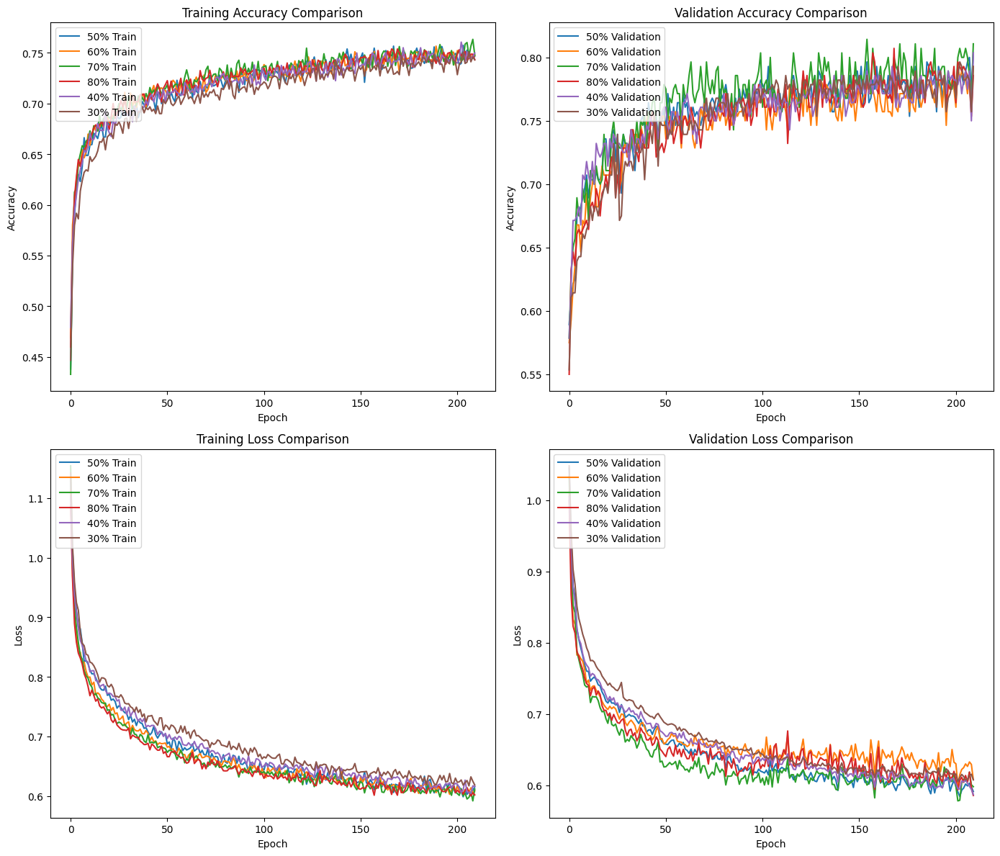

In [58]:
histories = [history_Hydrid_1, history_Hydrid_2, history_Hydrid_3, history_Hydrid_4,history_Hydrid_5,history_Hydrid_6]
labels = ['50%','60%', '70%', '80%', '40%', '30%']
plot_split_metrics(histories, labels)

In [74]:
model_RProp ,history_RProp , test_loss_RProp , test_accuracy_RProp  = build_model_k_fold(
            input_dim, output_dim, X_train.shape[0], hidden_neutron_ratio, hidden_layers,
            hidden_activation, output_activation, loss_function, RpropOptimizer2(initial_step_size, increase_factor, decrease_factor), epochs, batch_size, X_train, y_train, X_val, y_val)

model_Adam ,history_Adam , test_loss_Adam , test_accuracy_Adam  = build_model_k_fold(
            input_dim, output_dim, X_train.shape[0], hidden_neutron_ratio, hidden_layers,
            hidden_activation, output_activation, loss_function, 'Adam', epochs, batch_size, X_train, y_train, X_val, y_val)

model_amsgrad ,history_amsgrad , test_loss_amsgrad , test_accuracy_amsgrad  = build_model_k_fold(
            input_dim, output_dim, X_train.shape[0], hidden_neutron_ratio, hidden_layers,
            hidden_activation, output_activation, loss_function, Adam(amsgrad=True), epochs, batch_size, X_train, y_train, X_val, y_val)

model_Hydrid ,history_Hydrid , test_loss_Hydrid , test_accuracy_Hydrid  = build_model_k_fold(
            input_dim, output_dim, X_train.shape[0], hidden_neutron_ratio, hidden_layers,
            hidden_activation, output_activation, loss_function, HydridAMSGradRPropOptimizer(0.7), epochs, batch_size, X_train, y_train, X_val, y_val)

Using Mini-Batch Gradient Descent with a set proportion (batch size = 126)
Epoch 1/210
21/21 [==============================] - 2s 22ms/step - loss: 1.1025 - accuracy: 0.4784 - val_loss: 0.9785 - val_accuracy: 0.5750
Epoch 2/210
21/21 [==============================] - 0s 8ms/step - loss: 0.9587 - accuracy: 0.5807 - val_loss: 0.8754 - val_accuracy: 0.6071
Epoch 3/210
21/21 [==============================] - 0s 8ms/step - loss: 0.8921 - accuracy: 0.6120 - val_loss: 0.8126 - val_accuracy: 0.6571
Epoch 4/210
21/21 [==============================] - 0s 7ms/step - loss: 0.8800 - accuracy: 0.6286 - val_loss: 0.8112 - val_accuracy: 0.6321
Epoch 5/210
21/21 [==============================] - 0s 7ms/step - loss: 0.8438 - accuracy: 0.6322 - val_loss: 0.7737 - val_accuracy: 0.7000
Epoch 6/210
21/21 [==============================] - 0s 7ms/step - loss: 0.8331 - accuracy: 0.6544 - val_loss: 0.7660 - val_accuracy: 0.6536
Epoch 7/210
21/21 [==============================] - 0s 7ms/step - loss: 0.823

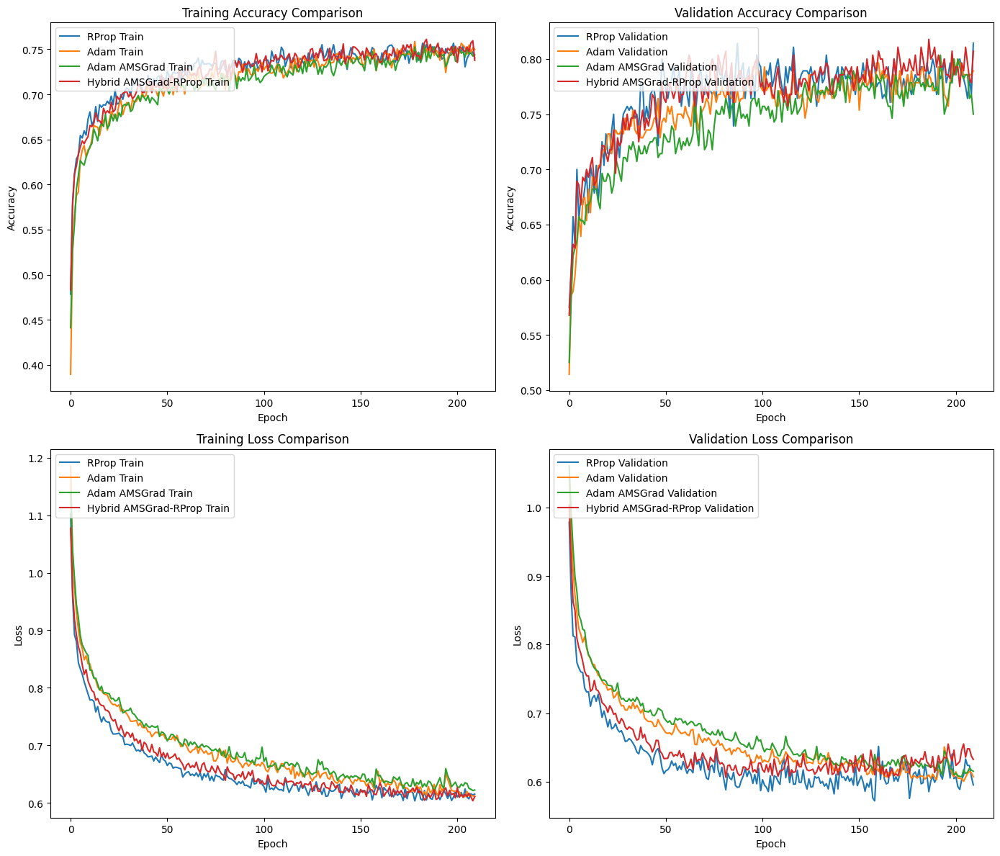

In [75]:
histories = [history_RProp, history_Adam, history_amsgrad, history_Hydrid]
labels = ['RProp','Adam', 'Adam AMSGrad', 'Hybrid AMSGrad-RProp']
plot_split_metrics(histories, labels)

In [76]:
k_fold_patterns = pd.concat([X_train_final, X_val_final, X_test_final], axis=0)
k_fold_labels = pd.concat([X_train_final['Type'], X_val_final['Type'], X_test_final['Type']], axis=0)
k = 10
kf = KFold(n_splits=k, shuffle=True, random_state=42)

RProp_Accuracies = []
RProp_Loss = []
Adam_Accuracies = []
Adam_Loss = []
AMSGrad_Accuracies = []
AMSGrad_Loss = []
Hydrid_Accuracies = []
Hybrid_Loss = []


fold = 1

for train_index, val_index in kf.split(k_fold_patterns):
    print(f"Training on fold {fold}...")

    X_train, X_val = k_fold_patterns.iloc[train_index].drop(columns=['Type']), k_fold_patterns.iloc[val_index].drop(columns=['Type'])
    y_train, y_val = k_fold_labels.iloc[train_index], k_fold_labels.iloc[val_index]


    model_RProp ,history_RProp , test_loss_RProp , test_accuracy_RProp  = build_model_k_fold(
                input_dim, output_dim, X_train.shape[0], hidden_neutron_ratio, hidden_layers,
                hidden_activation, output_activation, loss_function, RpropOptimizer2(initial_step_size, increase_factor, decrease_factor), epochs, batch_size, X_train, y_train, X_val, y_val)

    model_Adam ,history_Adam , test_loss_Adam , test_accuracy_Adam  = build_model_k_fold(
                input_dim, output_dim, X_train.shape[0], hidden_neutron_ratio, hidden_layers,
                hidden_activation, output_activation, loss_function, 'Adam', epochs, batch_size, X_train, y_train, X_val, y_val)

    model_amsgrad ,history_amsgrad , test_loss_amsgrad , test_accuracy_amsgrad  = build_model_k_fold(
                input_dim, output_dim, X_train.shape[0], hidden_neutron_ratio, hidden_layers,
                hidden_activation, output_activation, loss_function, Adam(amsgrad=True), epochs, batch_size, X_train, y_train, X_val, y_val)

    model_Hydrid ,history_Hydrid , test_loss_Hydrid , test_accuracy_Hydrid  = build_model_k_fold(
                input_dim, output_dim, X_train.shape[0], hidden_neutron_ratio, hidden_layers,
                hidden_activation, output_activation, loss_function, HydridAMSGradRPropOptimizer(0.7), epochs, batch_size, X_train, y_train, X_val, y_val)


    RProp_Accuracies.append( test_accuracy_RProp)
    RProp_Loss.append(test_loss_RProp)
    Adam_Accuracies.append(test_accuracy_Adam )
    Adam_Loss.append(test_loss_Adam)
    AMSGrad_Accuracies.append(test_accuracy_amsgrad)
    AMSGrad_Loss.append(test_loss_amsgrad)
    Hydrid_Accuracies.append(test_accuracy_Hydrid)
    Hybrid_Loss.append(test_loss_Hydrid)
    fold += 1


avg_accuracy_RProp = np.mean(RProp_Accuracies)
avg_accuracy_Adam = np.mean(Adam_Accuracies)
avg_accuracy_AMSGrad = np.mean(AMSGrad_Accuracies)
avg_accuracy_Hydrid = np.mean(Hydrid_Accuracies)

avg_loss_RProp = np.mean(RProp_Loss)
avg_loss_Adam = np.mean(Adam_Loss)
avg_loss_AMSGrad = np.mean(AMSGrad_Loss)
avg_loss_Hydrid = np.mean(Hybrid_Loss)


results = {
    'Optimizer': ['RProp', 'Adam', 'AMSGrad', 'Hybrid'],
    'Fold 1': [RProp_Accuracies[0],
               Adam_Accuracies[0],
               AMSGrad_Accuracies[0],
               Hydrid_Accuracies[0]],
    'Fold 2': [RProp_Accuracies[1],
               Adam_Accuracies[1],
               AMSGrad_Accuracies[1],
               Hydrid_Accuracies[1]],
    'Fold 3': [RProp_Accuracies[2],
               Adam_Accuracies[2],
               AMSGrad_Accuracies[2],
               Hydrid_Accuracies[2]],
    'Fold 4': [RProp_Accuracies[3],
               Adam_Accuracies[3],
               AMSGrad_Accuracies[3],
               Hydrid_Accuracies[3]],
    'Fold 5': [RProp_Accuracies[4],
               Adam_Accuracies[4],
               AMSGrad_Accuracies[4],
               Hydrid_Accuracies[4]],
    'Fold 6': [RProp_Accuracies[5],
               Adam_Accuracies[5],
               AMSGrad_Accuracies[5],
               Hydrid_Accuracies[5]],
    'Fold 7': [RProp_Accuracies[6],
               Adam_Accuracies[6],
               AMSGrad_Accuracies[6],
               Hydrid_Accuracies[6]],
    'Fold 8': [RProp_Accuracies[7],
               Adam_Accuracies[7],
               AMSGrad_Accuracies[7],
               Hydrid_Accuracies[7]],
    'Fold 9': [RProp_Accuracies[8],
               Adam_Accuracies[8],
               AMSGrad_Accuracies[8],
               Hydrid_Accuracies[8]],
    'Fold 10': [RProp_Accuracies[9],
                Adam_Accuracies[9],
                AMSGrad_Accuracies[9],
                Hydrid_Accuracies[9]],
    'Average': [avg_accuracy_RProp,
                avg_accuracy_Adam,
                avg_accuracy_AMSGrad,
                avg_accuracy_Hydrid]
}


results_loss = {
    'Optimizer': ['RProp', 'Adam', 'AMSGrad', 'Hybrid'],
    'Fold 1': [RProp_Loss[0],
               Adam_Loss[0],
               AMSGrad_Loss[0],
               Hybrid_Loss[0]],
    'Fold 2': [RProp_Loss[1],
               Adam_Loss[1],
               AMSGrad_Loss[1],
               Hybrid_Loss[1]],
    'Fold 3': [RProp_Loss[2],
               Adam_Loss[2],
               AMSGrad_Loss[2],
               Hybrid_Loss[2]],
    'Fold 4': [RProp_Loss[3],
               Adam_Loss[3],
               AMSGrad_Loss[3],
               Hybrid_Loss[3]],
    'Fold 5': [RProp_Loss[4],
               Adam_Loss[4],
               AMSGrad_Loss[4],
               Hybrid_Loss[4]],
    'Fold 6': [RProp_Loss[5],
               Adam_Loss[5],
               AMSGrad_Loss[5],
               Hybrid_Loss[5]],
    'Fold 7': [RProp_Loss[6],
               Adam_Loss[6],
               AMSGrad_Loss[6],
               Hybrid_Loss[6]],
    'Fold 8': [RProp_Loss[7],
               Adam_Loss[7],
               AMSGrad_Loss[7],
               Hybrid_Loss[7]],
    'Fold 9': [RProp_Loss[8],
               Adam_Loss[8],
               AMSGrad_Loss[8],
               Hybrid_Loss[8]],
    'Fold 10': [RProp_Loss[9],
                Adam_Loss[9],
                AMSGrad_Loss[9],
                Hybrid_Loss[9]],
    'Average': [avg_loss_RProp,
                avg_loss_Adam,
                avg_loss_AMSGrad,
                avg_loss_Hydrid]
}



results_df = pd.DataFrame(results)

display(results_df )
results_df_2 = pd.DataFrame(results_loss)

display(results_df_2 )


Training on fold 1...
Using Mini-Batch Gradient Descent with a set proportion (batch size = 126)
Epoch 1/210
21/21 [==============================] - 4s 14ms/step - loss: 1.0931 - accuracy: 0.4659 - val_loss: 0.9435 - val_accuracy: 0.6121
Epoch 2/210
21/21 [==============================] - 0s 8ms/step - loss: 0.9555 - accuracy: 0.5777 - val_loss: 0.8641 - val_accuracy: 0.6335
Epoch 3/210
21/21 [==============================] - 0s 8ms/step - loss: 0.8930 - accuracy: 0.6090 - val_loss: 0.8289 - val_accuracy: 0.6548
Epoch 4/210
21/21 [==============================] - 0s 8ms/step - loss: 0.8453 - accuracy: 0.6443 - val_loss: 0.7893 - val_accuracy: 0.7117
Epoch 5/210
21/21 [==============================] - 0s 8ms/step - loss: 0.8456 - accuracy: 0.6495 - val_loss: 0.7752 - val_accuracy: 0.6940
Epoch 6/210
21/21 [==============================] - 0s 8ms/step - loss: 0.8170 - accuracy: 0.6554 - val_loss: 0.7559 - val_accuracy: 0.6833
Epoch 7/210
21/21 [==============================] - 0s 

,Optimizer,Fold 1,Fold 2,Fold 3,Fold 4,Fold 5,Fold 6,Fold 7,Fold 8,Fold 9,Fold 10,Average
0,RProp,0.725979,0.718861,0.786477,0.760714,0.696429,0.746429,0.778571,0.721429,0.714286,0.782143,0.743132
1,Adam,0.740214,0.736655,0.775801,0.764286,0.703571,0.753571,0.771429,0.717857,0.714286,0.771429,0.744910
2,AMSGrad,0.754448,0.740214,0.747331,0.742857,0.700000,0.742857,0.753571,0.721429,0.692857,0.753571,0.734914
3,Hybrid,0.747331,0.722420,0.772242,0.739286,0.707143,0.753571,0.760714,0.714286,0.725000,0.800000,0.744199


,Optimizer,Fold 1,Fold 2,Fold 3,Fold 4,Fold 5,Fold 6,Fold 7,Fold 8,Fold 9,Fold 10,Average
0,RProp,0.610164,0.711450,0.564328,0.617393,0.680133,0.629647,0.587892,0.665832,0.651477,0.606054,0.632437
1,Adam,0.605129,0.699325,0.598775,0.626469,0.662880,0.602614,0.605811,0.656617,0.646704,0.606953,0.631128
2,AMSGrad,0.591740,0.706941,0.603855,0.632177,0.671702,0.622832,0.604110,0.645225,0.642183,0.622203,0.634297
3,Hybrid,0.581132,0.717671,0.571717,0.614515,0.646490,0.607663,0.611186,0.639539,0.640914,0.592437,0.622327
